In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import anndata
import os
from scipy import sparse
import collections
import scrublet as scr
import matplotlib.pyplot as plt
import time
import seaborn as sns
import random
import scipy
from collections import Counter
import scipy.io
import jp_single

import scvi

sc.settings.verbosity = 3
sc.settings.set_figure_params(dpi=100, color_map='YlOrRd')
sc.logging.print_version_and_date()
# 把MuSC 和Myocyte clean的细胞拿出来聚一下类

# 用MuSC 和 Myocyte信息来整合数据

Running Scanpy 1.8.0, on 2023-02-17 15:20.


In [2]:
from IPython.core.interactiveshell import InteractiveShell

InteractiveShell.ast_node_interactivity = "all" # to show output from all the lines in a cells

In [3]:
pd.set_option('display.max_column',None) # display all the columns in pandas
pd.options.display.max_rows = 100

***
Import data

In [4]:
rawadata = sc.read('./write/skm_cells_human_cellbender.raw_2021-03-24.h5ad')
adata_MuSC = sc.read('./write/humsn_SKM_MuSC_scVI_v1.3_adata.h5ad')
adata_Myocyte = sc.read('./write/humsn_SKM_Myocyte_scVI_v2.0_adata.h5ad')

In [5]:
adata_MuSC

AnnData object with n_obs × n_vars = 16955 × 10000
    obs: 'sample', 'barcode', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ', 'Age_bin', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'leiden', 'annotation', 'leiden_R'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: '10X version _colors', 'DonorID_colors', '_scvi', 'annotation_colors', 'hvg', 'leiden', 'leiden_R_colors', 'leiden_colors', 'neighbors', 'umap'
    obsm: 'X_scVI', 'X_umap'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [6]:
adata_Myocyte

AnnData object with n_obs × n_vars = 12415 × 10000
    obs: 'sample', 'barcode', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ', 'Age_bin', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'leiden', 'annotation'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'DonorID_colors', '_scvi', 'annotation_colors', 'hvg', 'leiden', 'leiden_R_colors', 'leiden_colors', 'neighbors', 'umap'
    obsm: 'X_scVI', 'X_umap'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [7]:
collections.Counter(adata_MuSC.obs['annotation'])

Counter({'5-MYOG+MuSCs': 65,
         '7-FB_Doubl': 63,
         '3-MuSCs': 12767,
         '1-Doubl_Mix1': 1220,
         '2-TNFRSF12A+MuSCs': 1203,
         '0-ICAM1+MuSCs': 1571,
         '8-SKM': 21,
         '4-ECs': 34,
         '6-AZU1+Neutrophil': 11})

In [8]:
collections.Counter(adata_Myocyte.obs['annotation'])

Counter({'1-TNNT1+Myocytes': 5385,
         '7-HOOK2+Myocytes': 142,
         '5-Doubl_Mix': 1136,
         '2-TNNT1+UCHL1+Myocytes': 597,
         '0-TNNT3+Myocytes': 4745,
         '4-TNNT2+Myocytes': 45,
         '3-TNNT3+UCHL1+Myocytes': 220,
         '6-MYH8+Myocytes': 145})

In [9]:
cell_list1 = adata_MuSC[adata_MuSC.obs['annotation']=='0-ICAM1+MuSCs'].obs.index
cell_list2 = adata_MuSC[adata_MuSC.obs['annotation']=='2-TNFRSF12A+MuSCs'].obs.index
cell_list3 = adata_MuSC[adata_MuSC.obs['annotation']=='3-MuSCs'].obs.index
cell_list4 = adata_MuSC[adata_MuSC.obs['annotation']=='5-MYOG+MuSCs'].obs.index
cell_list5 = adata_Myocyte[adata_Myocyte.obs['annotation']=='0-TNNT3+Myocytes'].obs.index
cell_list6 = adata_Myocyte[adata_Myocyte.obs['annotation']=='1-TNNT1+Myocytes'].obs.index
cell_list7 = adata_Myocyte[adata_Myocyte.obs['annotation']=='2-TNNT1+UCHL1+Myocytes'].obs.index
cell_list8 = adata_Myocyte[adata_Myocyte.obs['annotation']=='3-TNNT3+UCHL1+Myocytes'].obs.index
cell_list9 = adata_Myocyte[adata_Myocyte.obs['annotation']=='4-TNNT2+Myocytes'].obs.index
cell_list10 = adata_Myocyte[adata_Myocyte.obs['annotation']=='6-MYH8+Myocytes'].obs.index
cell_list11 = adata_Myocyte[adata_Myocyte.obs['annotation']=='7-HOOK2+Myocytes'].obs.index

cell_list = cell_list1.append(cell_list2).append(cell_list3).append(cell_list4).append(cell_list5).append(cell_list6).append(cell_list7).append(cell_list8).append(cell_list9).append(cell_list10).append(cell_list11)

In [10]:
adata = rawadata[cell_list]

In [11]:
adata.layers['counts'] = adata.X.copy()

In [12]:
adata

AnnData object with n_obs × n_vars = 26885 × 33694
    obs: 'sample', 'barcode', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ', 'Age_bin', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells'
    layers: 'counts'

In [13]:
adata_MuSC.obs['cell_type']='MuSC'
adata_Myocyte.obs['cell_type']='Myocyte'

In [14]:
adata.obs['cell_type'] = adata_MuSC.obs['cell_type']
adata.obs.update(adata_Myocyte.obs)

In [15]:
adata.obs['annotation'] = adata_MuSC.obs['annotation']
adata.obs.update(adata_Myocyte.obs)

In [16]:
adata

AnnData object with n_obs × n_vars = 26885 × 33694
    obs: 'sample', 'barcode', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ', 'Age_bin', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'cell_type', 'annotation'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells'
    layers: 'counts'

In [17]:
collections.Counter(adata.obs['cell_type'])

Counter({'MuSC': 15606, 'Myocyte': 11279})

In [18]:
collections.Counter(adata.obs['annotation'])

Counter({'0-ICAM1+MuSCs': 1571,
         '2-TNFRSF12A+MuSCs': 1203,
         '3-MuSCs': 12767,
         '5-MYOG+MuSCs': 65,
         '0-TNNT3+Myocytes': 4745,
         '1-TNNT1+Myocytes': 5385,
         '2-TNNT1+UCHL1+Myocytes': 597,
         '3-TNNT3+UCHL1+Myocytes': 220,
         '4-TNNT2+Myocytes': 45,
         '6-MYH8+Myocytes': 145,
         '7-HOOK2+Myocytes': 142})

In [19]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.raw = adata  # keep full dimension safe

normalizing counts per cell
    finished (0:00:00)


In [20]:
sc.pp.highly_variable_genes(
    adata,
    flavor="seurat_v3",
    n_top_genes=10000,
    layer="counts",
    batch_key='cell_type', subset = True)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


In [21]:
adata

AnnData object with n_obs × n_vars = 26885 × 10000
    obs: 'sample', 'barcode', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ', 'Age_bin', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'cell_type', 'annotation'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p', 'hvg'
    layers: 'counts'

In [22]:
scvi.data.setup_anndata(adata,layer="counts", batch_key="DonorID",
                        #categorical_covariate_keys=["10X version ", "cell_type"],
                        #continuous_covariate_keys=["percent_mito",'percent_ribo']
                       )

INFO     Using batches from adata.obs["DonorID"]                                             
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.layers["counts"]                                              
INFO     Computing library size prior per batch                                              
INFO     Successfully registered anndata object containing 26885 cells, 10000 vars, 10       
         batches, 1 labels, and 0 proteins. Also registered 0 extra categorical covariates   
         and 0 extra continuous covariates.                                                  
INFO     Please do not further modify adata until model is trained.                          


In [23]:
vae = scvi.model.SCVI(adata, n_layers=2, n_latent=30)

In [24]:
vae.train()

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 298/298: 100%|██████████| 298/298 [15:40<00:00,  3.16s/it, loss=1.71e+03, v_num=1]


In [25]:
adata.obsm["X_scVI"] = vae.get_latent_representation()

In [26]:
sc.pp.neighbors(adata, use_rep="X_scVI")
sc.tl.leiden(adata)
sc.tl.umap(adata)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:24)
running Leiden clustering
    finished: found 13 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:04)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:26)


In [14]:
adata.write('./write/humsn_SKM_MuSC_Myocyte_scVI_v1.3_adata.h5ad')

In [4]:
adata = sc.read('./write/humsn_SKM_MuSC_Myocyte_scVI_v1.3_adata.h5ad')

In [7]:
adata

AnnData object with n_obs × n_vars = 26885 × 10000
    obs: 'sample', 'barcode', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ', 'Age_bin', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'cell_type', 'annotation', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'leiden', 'annotation_1', 'annotation_2'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: '_scvi', 'annotation_1_colors', 'annotation_1_sizes', 'annotation_2_colors', 'annotation_colors', 'draw_graph', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'paga', 'umap'
    obsm: 'X_draw_graph_fa', 'X_scVI', 'X_umap'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

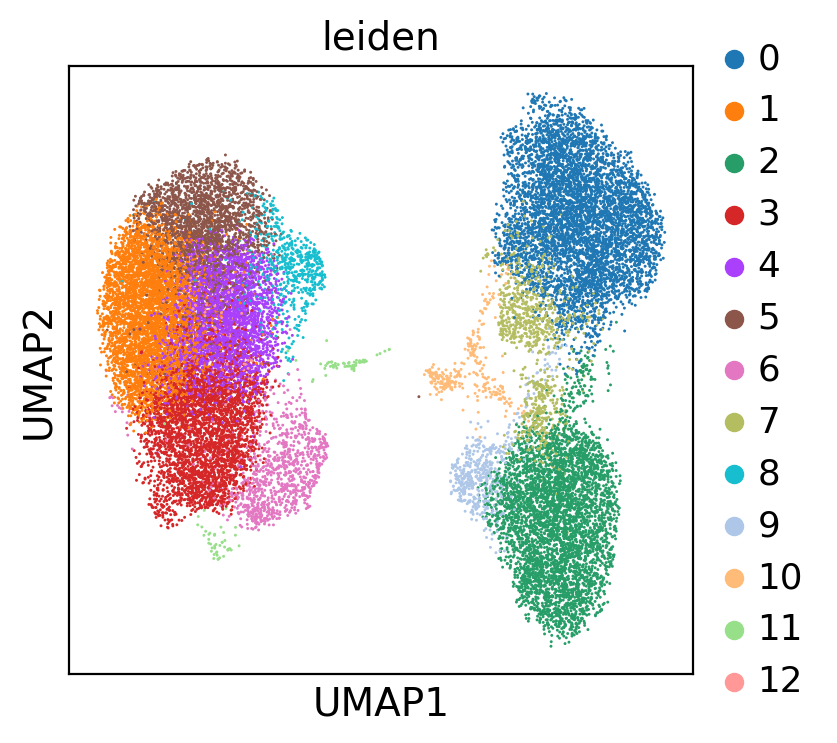

In [6]:
sc.pl.umap(adata, color=['leiden',],)

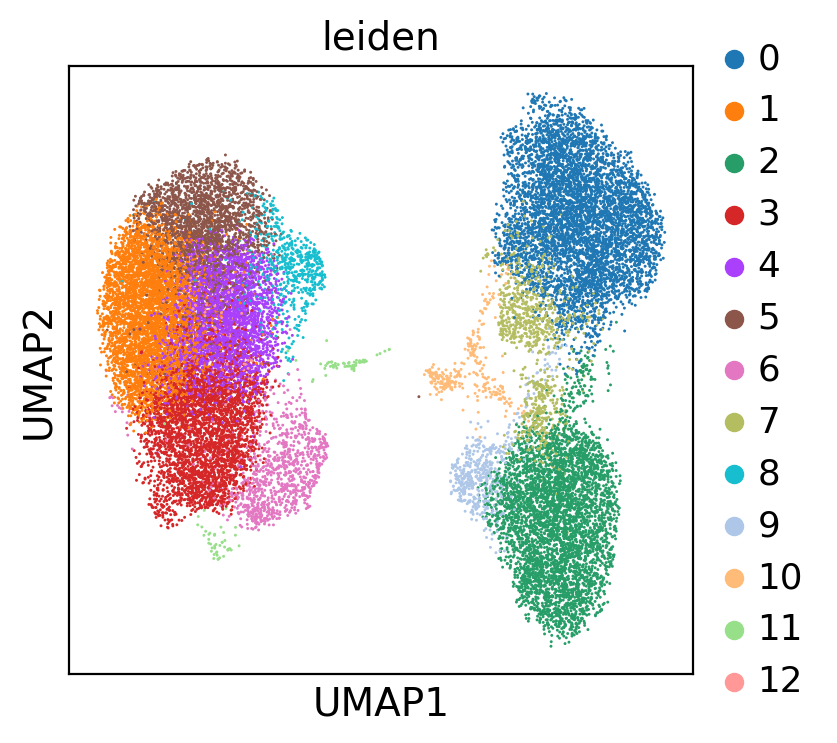

In [6]:
sc.pl.umap(adata, color=['leiden',],)

In [68]:
adata

AnnData object with n_obs × n_vars = 26885 × 10000
    obs: 'sample', 'barcode', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ', 'Age_bin', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'cell_type', 'annotation', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'leiden', 'annotation_1'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: '_scvi', 'hvg', 'leiden', 'neighbors', 'umap', 'leiden_colors', 'draw_graph', 'annotation_colors', 'annotation_1_colors', 'paga', 'annotation_1_sizes'
    obsm: 'X_scVI', 'X_umap', 'X_draw_graph_fa'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

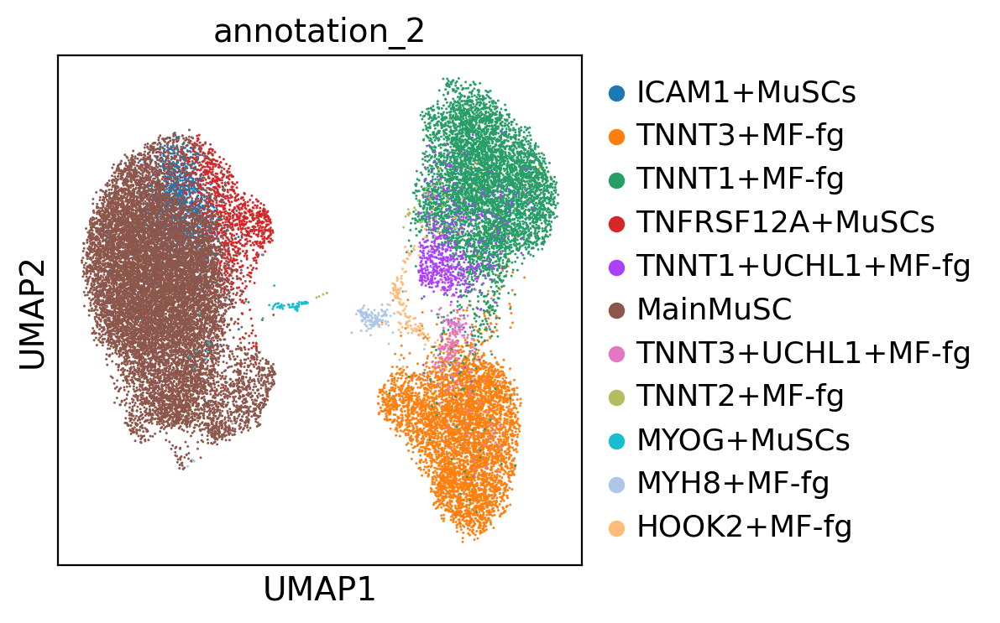

In [141]:
sc.pl.umap(adata, color=['annotation_2',],save='humsn_SKM_MuSC_Myocyte_scVI_v1.3_annotation1.pdf')

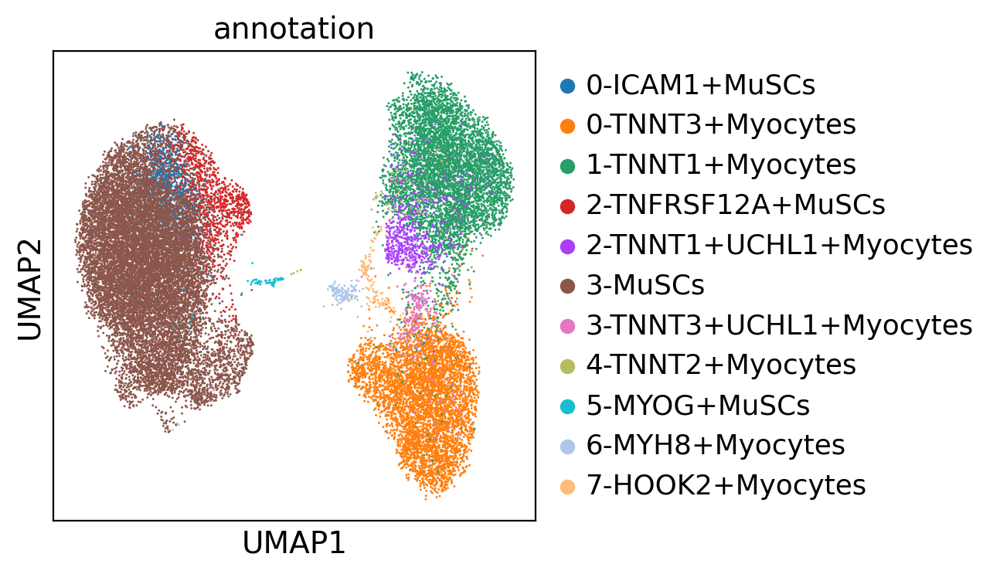

In [7]:
sc.pl.umap(adata, color=['annotation',],)

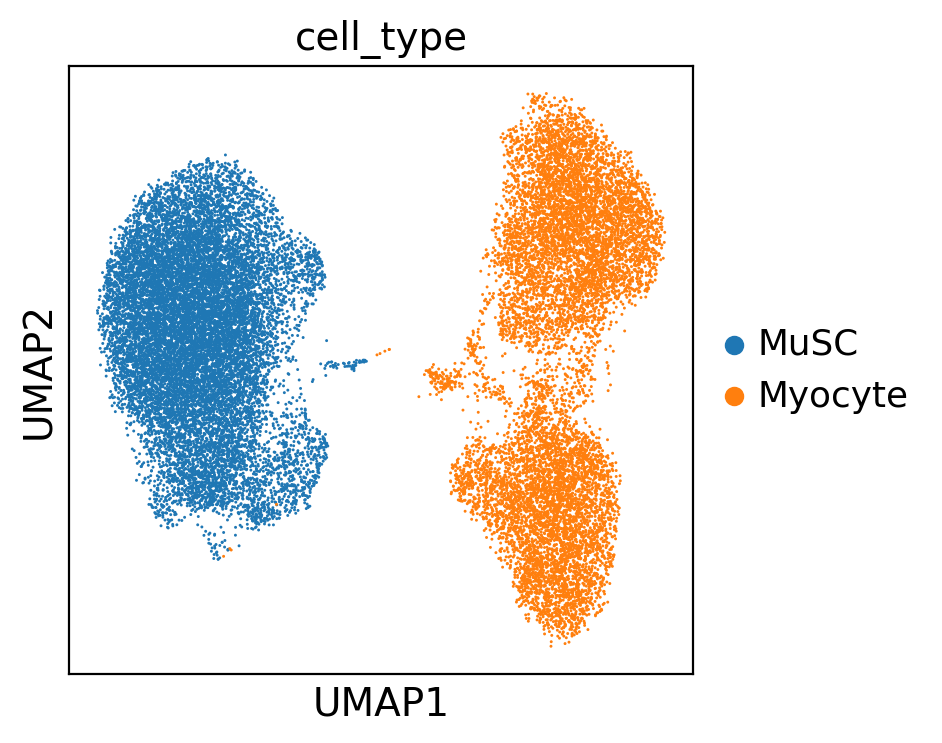

In [114]:
sc.pl.umap(adata, color=['cell_type',],save='humsn_SKM_MuSC_Myocyte_scVI_v1.3_muscmyocyte.pdf')

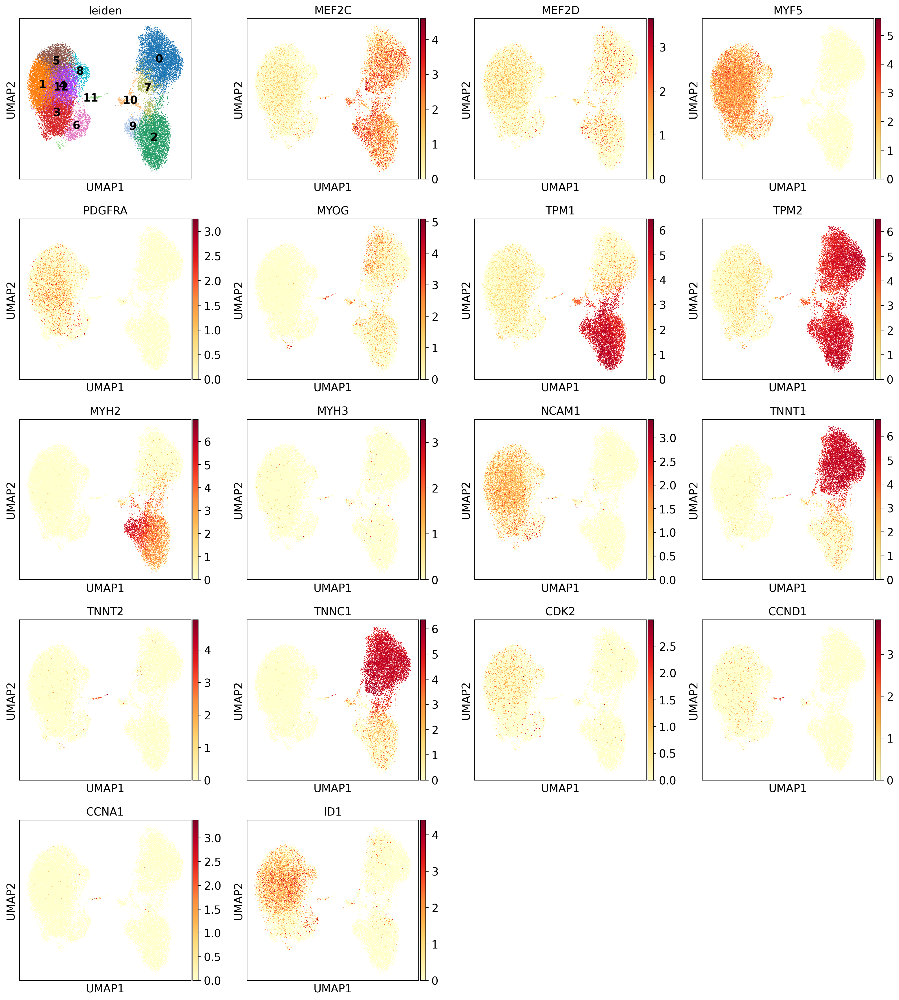

In [50]:
sc.pl.umap(adata, color=['leiden',"MEF2C", "MEF2D", "MYF5","PDGFRA","MYOG","TPM1",  "TPM2",  "MYH2","MYH3",  "NCAM1", "TNNT1","TNNT2", "TNNC1",
                                          "CDK2","CCND1", "CCNA1", "ID1"],legend_loc='on data',)

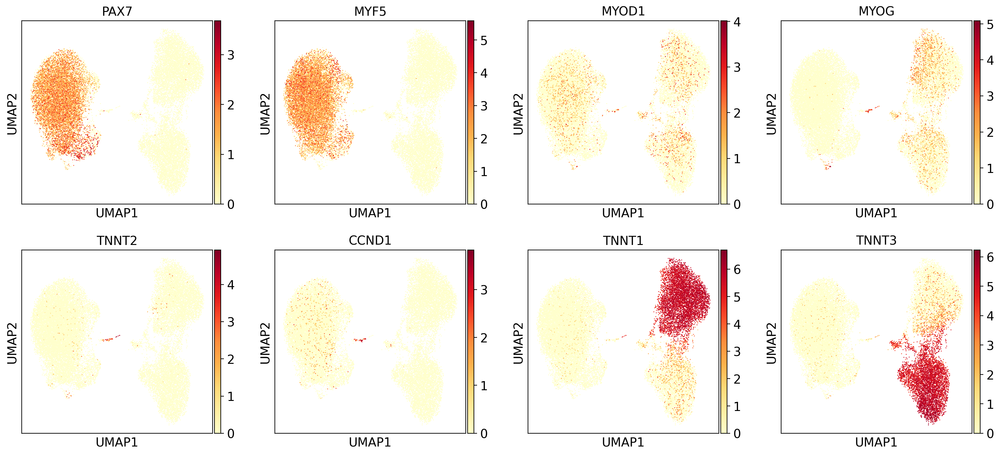

In [73]:
sc.pl.umap(adata, color=['PAX7',"MYF5",'MYOD1',"MYOG","TNNT2","CCND1","TNNT1",'TNNT3',],)

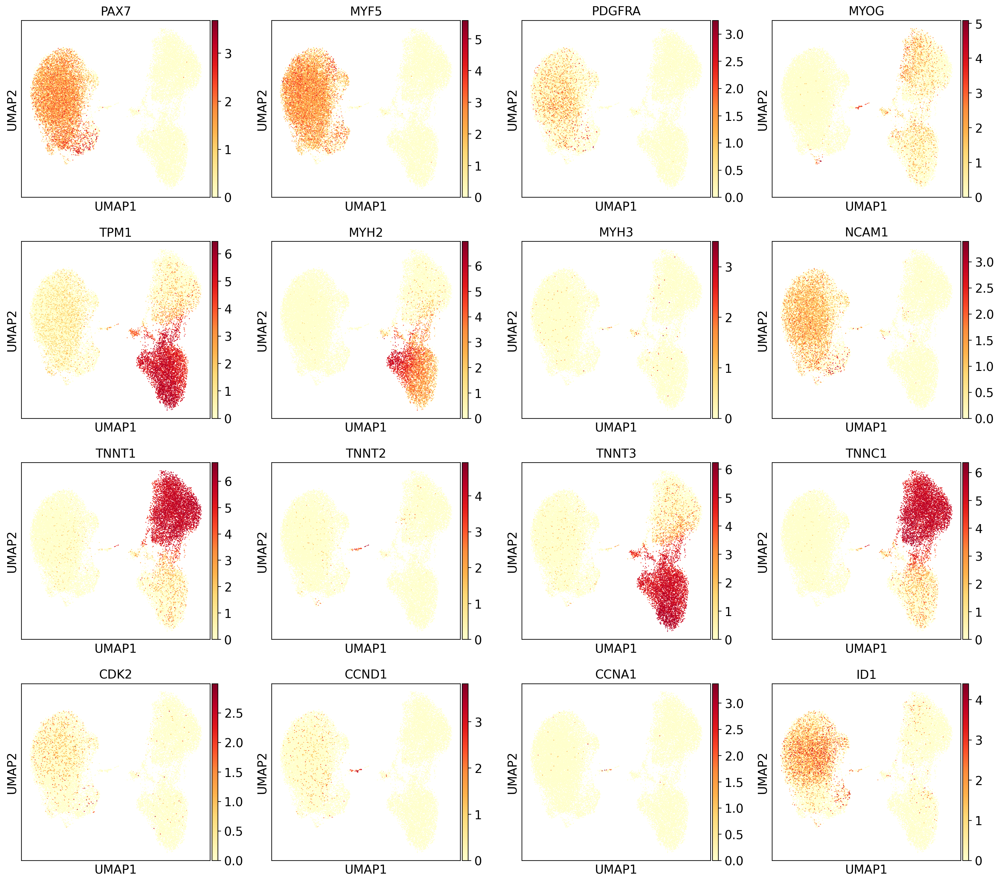

In [67]:
sc.pl.umap(adata, color=['PAX7',"MYF5","PDGFRA","MYOG","TPM1", "MYH2","MYH3",  "NCAM1", "TNNT1","TNNT2",'TNNT3', "TNNC1",
                                          "CDK2","CCND1", "CCNA1", "ID1"],)

In [ ]:
'PAX7',"MEF2C", "MEF2D", "MYF5","PDGFRA","MYOG","TPM1",  "TPM2",  "MYH2","MYH3",  "NCAM1", "TNNT1","TNNT2",'TNNT3', "TNNC1",
                                          "CDK2","CCND1", "CCNA1", "ID1"

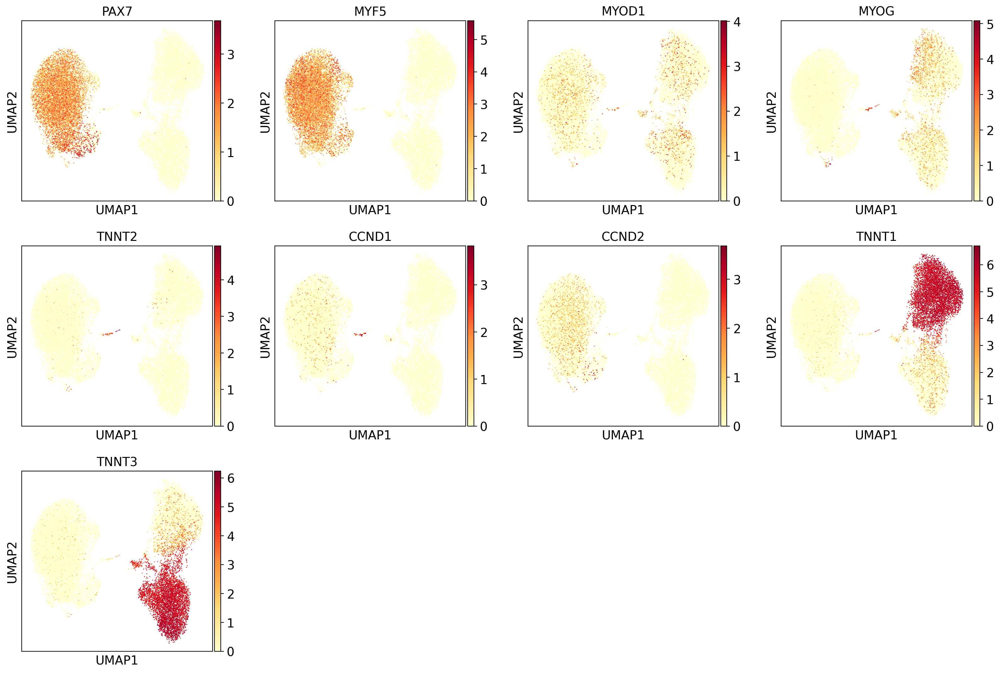

In [24]:
sc.pl.umap(adata, color=['PAX7','MYF5','MYOD1','MYOG','TNNT2','CCND1','CCND2','TNNT1','TNNT3'],)

In [ ]:
'MYMX','MYMK'

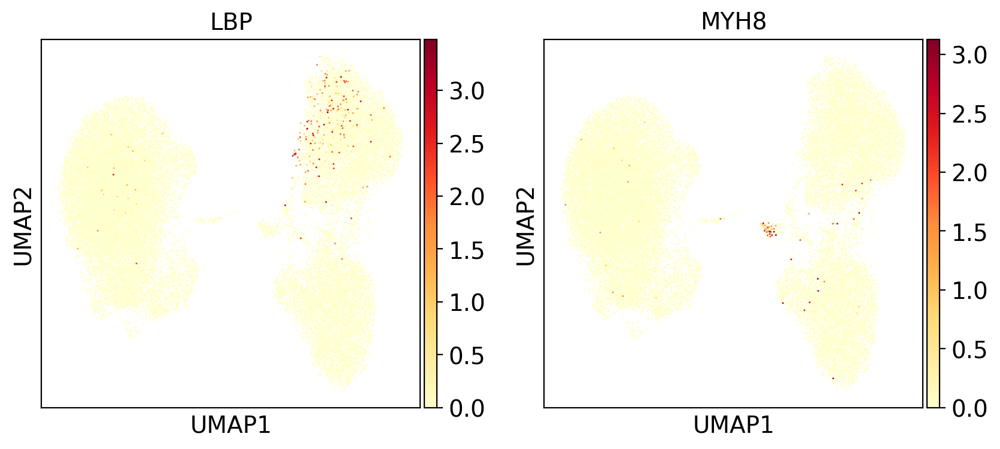

In [104]:
sc.pl.umap(adata, color=['LBP','MYH8'],)

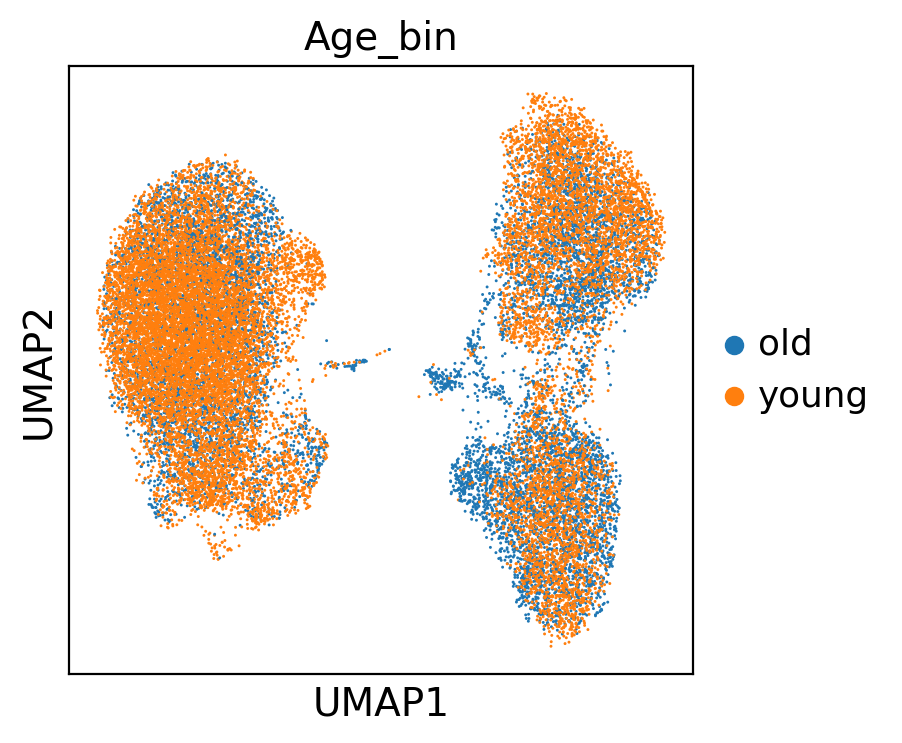

In [105]:
sc.pl.umap(adata, color=['Age_bin'],)

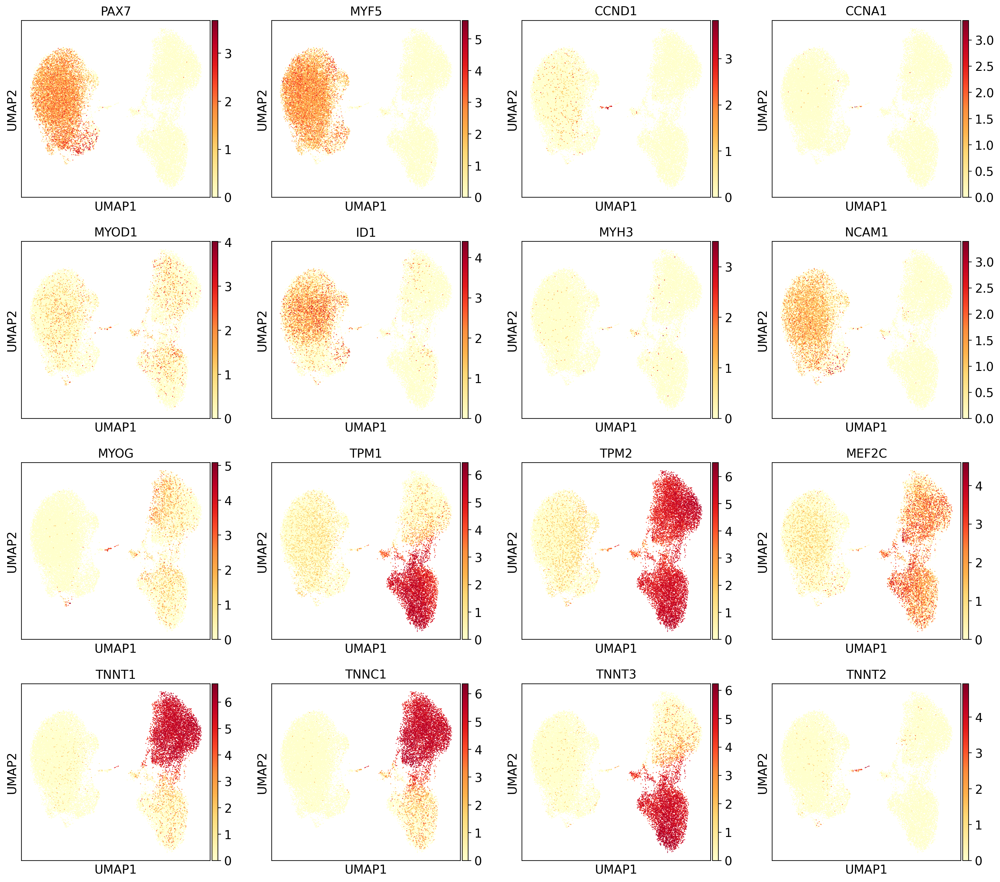

In [101]:
sc.pl.umap(adata, color=['PAX7','MYF5',"CCND1", "CCNA1",'MYOD1', "ID1","MYH3",  "NCAM1", "MYOG","TPM1",  "TPM2","MEF2C","TNNT1","TNNC1",'TNNT3','TNNT2'],save='humsn_SKM_MuSC_Myocyte_scVI_v1.3_myomarker.pdf')

In [8]:
adata

AnnData object with n_obs × n_vars = 26885 × 10000
    obs: 'sample', 'barcode', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ', 'Age_bin', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'cell_type', 'annotation', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'leiden', 'annotation_1'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: '_scvi', 'annotation_1_colors', 'annotation_1_sizes', 'annotation_colors', 'draw_graph', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'paga', 'umap'
    obsm: 'X_draw_graph_fa', 'X_scVI', 'X_umap'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [ ]:
'ICA+ MuSC','MF-II(fg)','MF-I(fg)','TNF+ MuSC','I-UCH(fg)','Main MuSC','II-UCH(fg)','TNNT2+(fg)','MyG+ MuSC','MYH8+','HOOK2+'

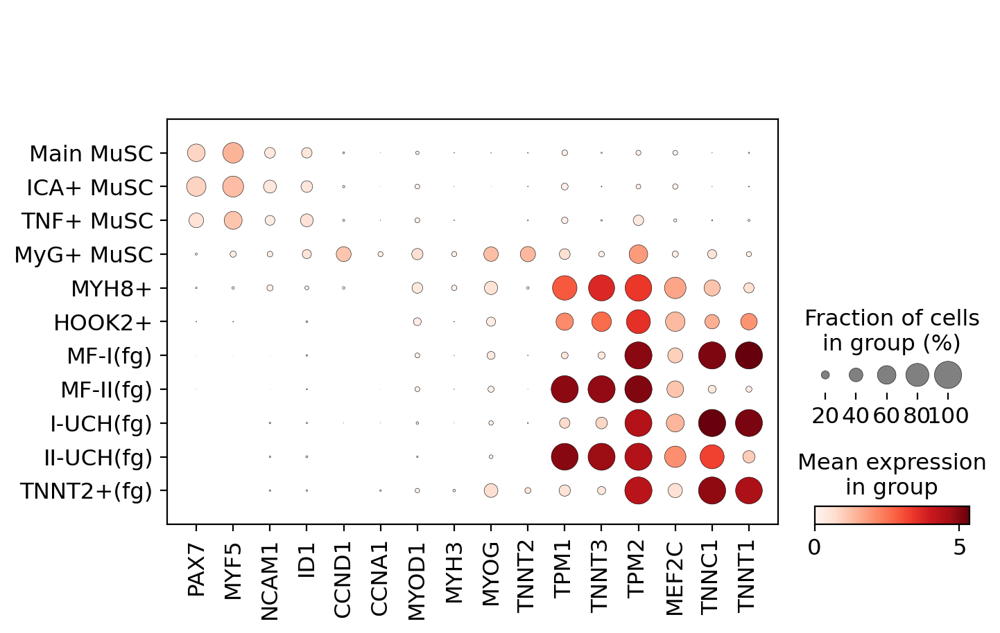

In [15]:
sc.pl.dotplot(adata,['PAX7','MYF5',"NCAM1","ID1","CCND1", "CCNA1",'MYOD1', "MYH3","MYOG",'TNNT2',"TPM1", 'TNNT3', "TPM2","MEF2C","TNNC1","TNNT1",],groupby='annotation_2',categories_order=['Main MuSC','ICA+ MuSC','TNF+ MuSC','MyG+ MuSC','MYH8+','HOOK2+','MF-I(fg)','MF-II(fg)','I-UCH(fg)','II-UCH(fg)','TNNT2+(fg)',],save='humsn_SKM_MuSC_Myocyte_scVI_v1.3_marker_v2.pdf')

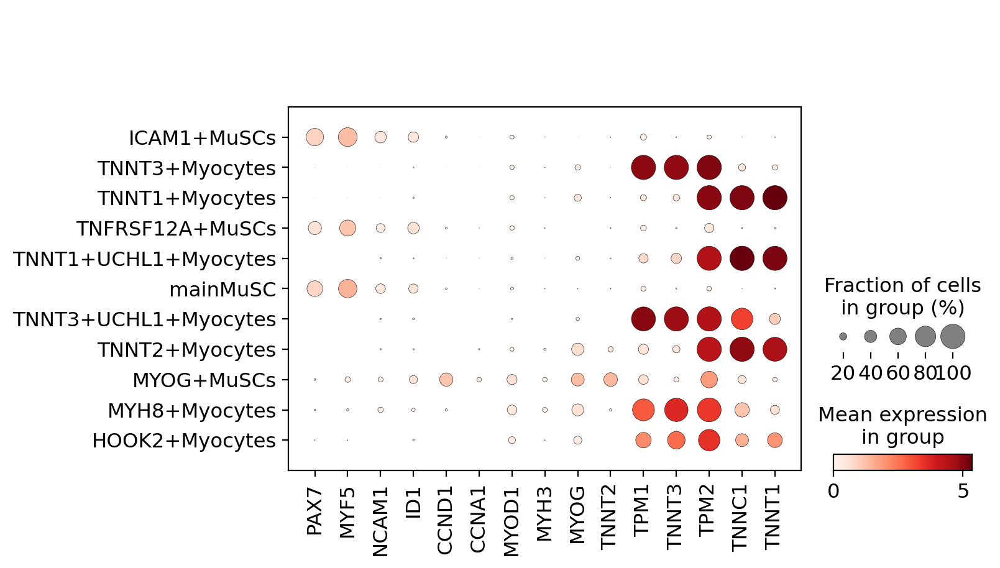

In [10]:
sc.pl.dotplot(adata,['PAX7','MYF5',"NCAM1","ID1","CCND1", "CCNA1",'MYOD1', "MYH3","MYOG",'TNNT2',"TPM1", 'TNNT3', "TPM2","TNNC1","TNNT1",],groupby='annotation_1',)#categories_order=['Main MuSC','ICA+ MuSC','TNF+ MuSC','MyG+ MuSC','MYH8+','HOOK2+','MF-II(fg)','II-UCH(fg)','MF-I(fg)','I-UCH(fg)','TNNT2+(fg)',],save='humsn_SKM_MuSC_Myocyte_scVI_v1.3_marker_v3.pdf')

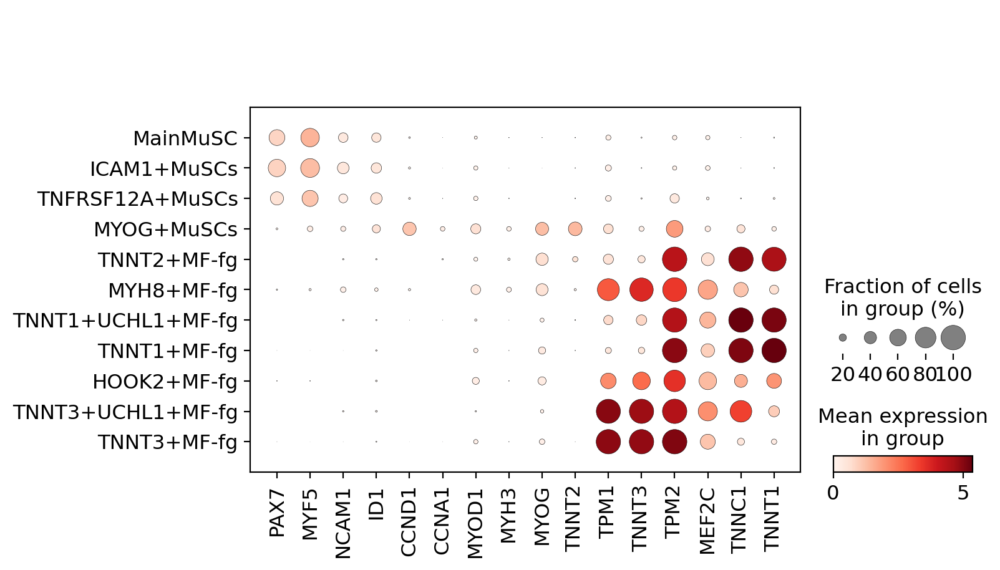

In [140]:
sc.pl.dotplot(adata,['PAX7','MYF5',"NCAM1","ID1","CCND1", "CCNA1",'MYOD1', "MYH3","MYOG",'TNNT2',"TPM1", 'TNNT3', "TPM2","MEF2C","TNNC1","TNNT1",],groupby='annotation_2',categories_order=['MainMuSC','ICAM1+MuSCs','TNFRSF12A+MuSCs','MYOG+MuSCs','TNNT2+MF-fg','MYH8+MF-fg','TNNT1+UCHL1+MF-fg','TNNT1+MF-fg','HOOK2+MF-fg','TNNT3+UCHL1+MF-fg','TNNT3+MF-fg',],save='humsn_SKM_MuSC_Myocyte_scVI_v1.3_marker.pdf')

In [51]:
adata

AnnData object with n_obs × n_vars = 26885 × 10000
    obs: 'sample', 'barcode', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ', 'Age_bin', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'cell_type', 'annotation', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'leiden', 'annotation_1'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: '_scvi', 'hvg', 'leiden', 'neighbors', 'umap', 'leiden_colors', 'draw_graph', 'annotation_colors', 'annotation_1_colors'
    obsm: 'X_scVI', 'X_umap', 'X_draw_graph_fa'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [57]:
adata.uns['annotation_1_colors']

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78']

In [56]:
adata.uns['umap']

{'params': {'a': 0.583030019901822, 'b': 1.3341669931033755}}

In [55]:
adata.obsm['X_umap'].shape

(26885, 2)

In [ ]:
sc.pl.umap(adata, color=['PAX7','MYF5','MYOD1','MYOG','TNNT2','CCND1','CCND2','TNNT1','TNNT3'],)

In [ ]:
### 构建moli文件

In [106]:
rawdata = sc.read('./write/skm_cells_human_cellbender.raw_2021-03-24.h5ad')

In [108]:
adata_raw = rawdata[adata.obs.index]

In [109]:
adata_raw

View of AnnData object with n_obs × n_vars = 26885 × 33694
    obs: 'sample', 'barcode', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ', 'Age_bin', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells'

In [110]:
adata

AnnData object with n_obs × n_vars = 26885 × 10000
    obs: 'sample', 'barcode', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ', 'Age_bin', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'cell_type', 'annotation', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'leiden', 'annotation_1', 'dpt_pseudotime'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: '_scvi', 'hvg', 'leiden', 'neighbors', 'umap', 'leiden_colors', 'draw_graph', 'annotation_colors', 'annotation_1_colors', 'paga', 'annotation_1_sizes', 'iroot', 'diffmap_evals', 'Age_bin_colors'
    obsm: 'X_scVI', 'X_umap', 'X_draw_graph_fa', 'X_diffmap'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [111]:
# 制作专门跑moli的数据
adata_diet = sc.AnnData(X = adata_raw.X, obs = adata.obs, var = adata_raw.var, obsm = adata.obsm )

In [112]:
adata_diet.write('./write/humsn_SKM_MuSC_Myocyte_scVI_v1.3_adata_diet.h5ad')

In [6]:
adata

AnnData object with n_obs × n_vars = 16955 × 10000
    obs: 'sample', 'barcode', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ', 'Age_bin', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'leiden', 'annotation', 'leiden_R'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: '10X version _colors', 'DonorID_colors', '_scvi', 'annotation_colors', 'hvg', 'leiden', 'leiden_R_colors', 'leiden_colors', 'neighbors', 'umap'
    obsm: 'X_scVI', 'X_umap'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

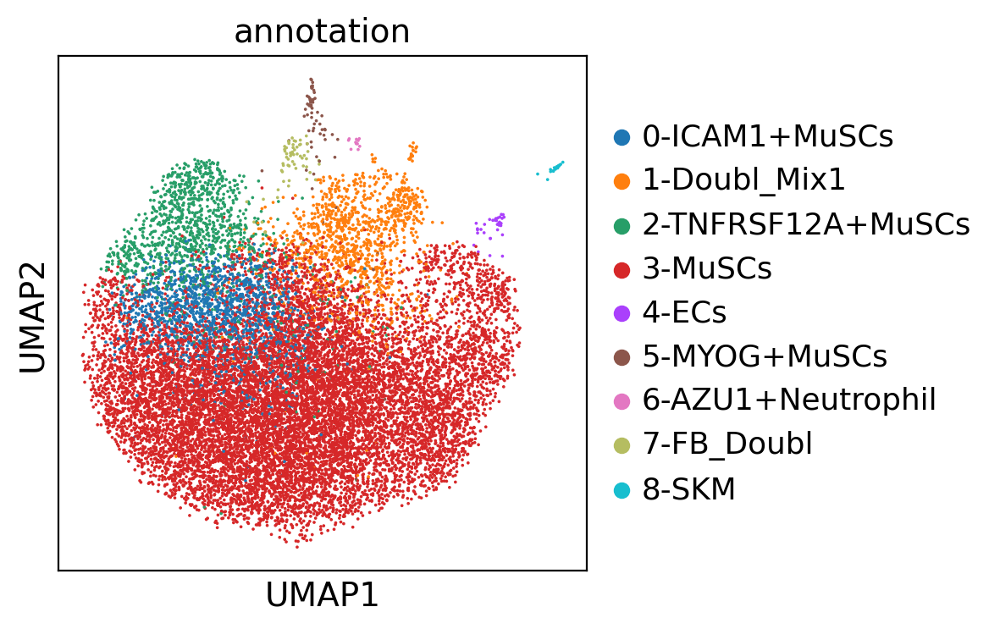

In [15]:
sc.pl.umap(adata, color=['annotation',],)

In [ ]:
"MEF2C", "MEF2D", "MYF5","ANPEP", "PDGFRA","MYOG","TPM1",  "TPM2",  "MYH2",
                                          "MYH3",  "NCAM1", "TNNT1",
                                          "TNNT2", "TNNC1", "CDK1",
                                          "CDK2",  "CCNB1", "CCNB2",
                                          "CCND1", "CCNA1", "ID1"

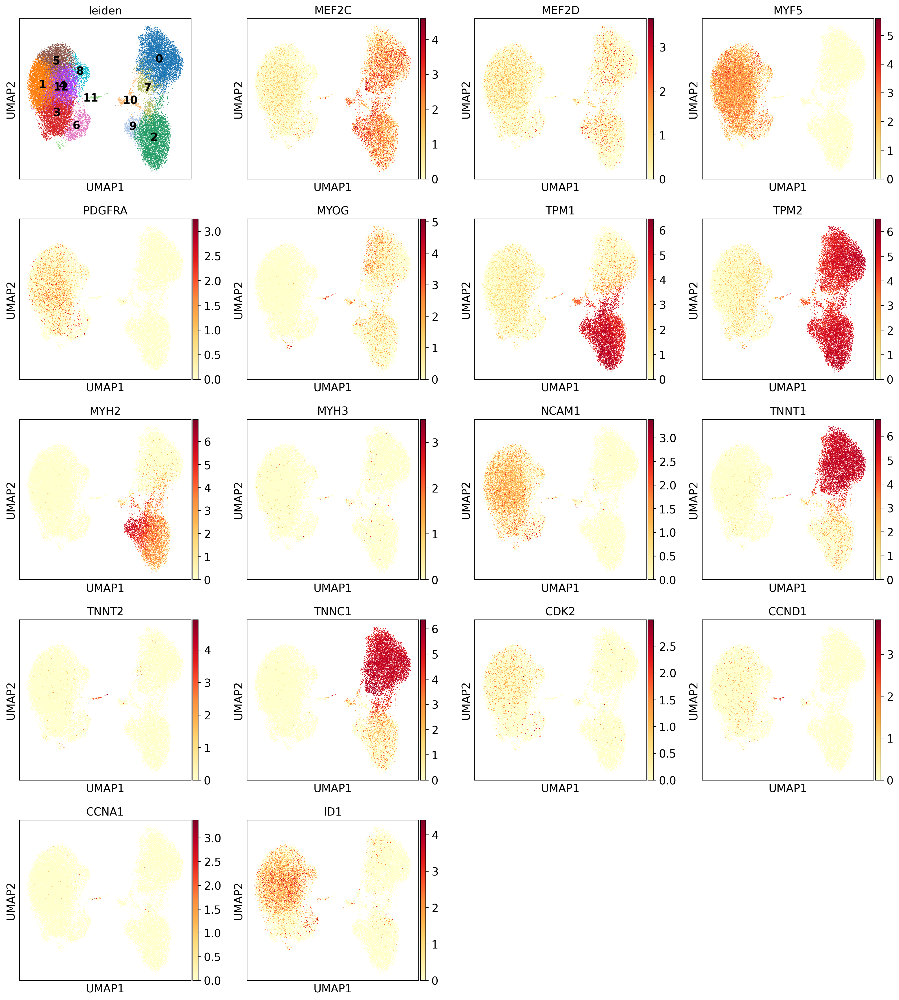

In [49]:
sc.pl.umap(adata, color=['leiden',"MEF2C", "MEF2D", "MYF5","PDGFRA","MYOG","TPM1",  "TPM2",  "MYH2","MYH3",  "NCAM1", "TNNT1","TNNT2", "TNNC1",
                                          "CDK2","CCND1", "CCNA1", "ID1"],legend_loc='on data',)

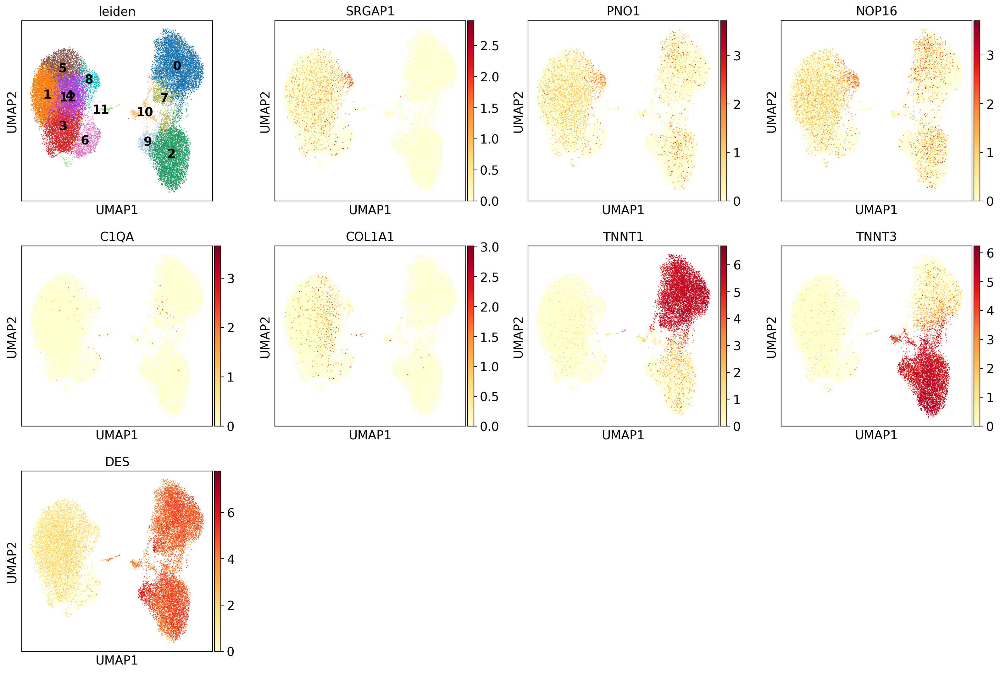

In [47]:
sc.pl.umap(adata, color=['leiden','SRGAP1', 'PNO1', 'NOP16', 'C1QA','COL1A1','TNNT1','TNNT3','DES'],legend_loc='on data',)

In [8]:
sc.tl.draw_graph(adata)

drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:04:05)


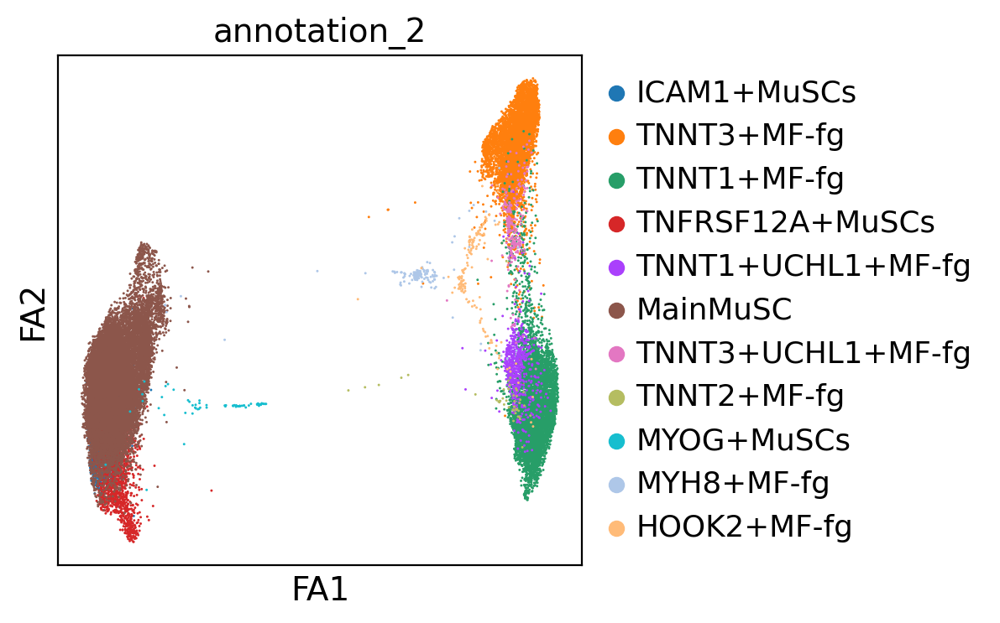

In [143]:
sc.pl.draw_graph(adata, color='annotation_2',save='humsn_SKM_MuSC_Myocyte_scVI_v1.3_drawgraph.pdf' )

In [74]:
adata

AnnData object with n_obs × n_vars = 26885 × 10000
    obs: 'sample', 'barcode', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ', 'Age_bin', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'cell_type', 'annotation', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'leiden', 'annotation_1'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: '_scvi', 'hvg', 'leiden', 'neighbors', 'umap', 'leiden_colors', 'draw_graph', 'annotation_colors', 'annotation_1_colors', 'paga', 'annotation_1_sizes'
    obsm: 'X_scVI', 'X_umap', 'X_draw_graph_fa'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [131]:
sc.tl.paga(adata, groups='annotation_2')

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)


--> added 'pos', the PAGA positions (adata.uns['paga'])


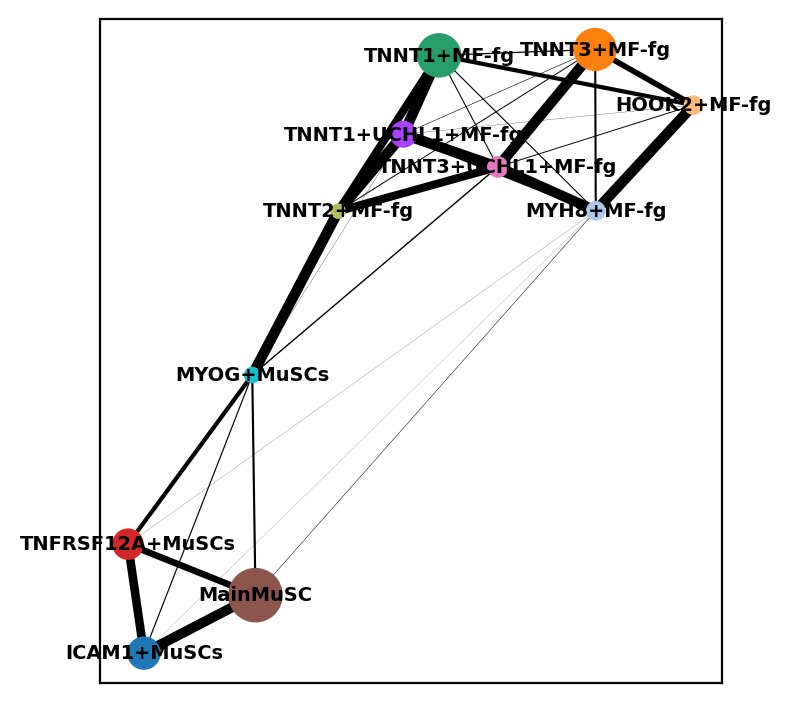

In [145]:
sc.pl.paga(adata, color=['annotation_2',],fontsize=7,edge_width_scale=.5,node_size_scale=.5,save='humsn_SKM_MuSC_Myocyte_scVI_v1.3_paga.pdf')

In [23]:
adata

AnnData object with n_obs × n_vars = 26885 × 10000
    obs: 'sample', 'barcode', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ', 'Age_bin', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'cell_type', 'annotation', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'leiden', 'annotation_1', 'annotation_2'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: '_scvi', 'annotation_1_colors', 'annotation_1_sizes', 'annotation_2_colors', 'annotation_colors', 'draw_graph', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'paga', 'umap'
    obsm: 'X_draw_graph_fa', 'X_scVI', 'X_umap'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [25]:
adata.obsm['X_draw_graph_fa']

array([[-29990.62914875,  -2508.51129454],
       [-27326.26380174,  -4221.75770175],
       [-29094.75056221,  -6841.68028945],
       ...,
       [ 30756.12572762,   3718.32303336],
       [ 30684.52454857,   3487.91560224],
       [ 36616.72509885,   8357.7016129 ]])

In [24]:
adata.uns['paga']

{'connectivities': <11x11 sparse matrix of type '<class 'numpy.float64'>'
 	with 76 stored elements in Compressed Sparse Row format>,
 'connectivities_tree': <11x11 sparse matrix of type '<class 'numpy.float64'>'
 	with 10 stored elements in Compressed Sparse Row format>,
 'groups': 'annotation_1',
 'pos': array([[-4.44622383, -3.15428642],
        [ 1.78127743,  1.54186149],
        [ 0.60170271,  0.28678009],
        [-3.3407625 , -2.82799865],
        [ 1.0148401 , -0.42466315],
        [-4.18303333, -3.8414964 ],
        [ 1.32497674,  0.34077524],
        [-0.01591149, -0.60713668],
        [-1.4175677 , -1.53771724],
        [ 2.25984379,  0.01336589],
        [ 2.36301521,  0.87608229]])}

--> added 'pos', the PAGA positions (adata.uns['paga'])


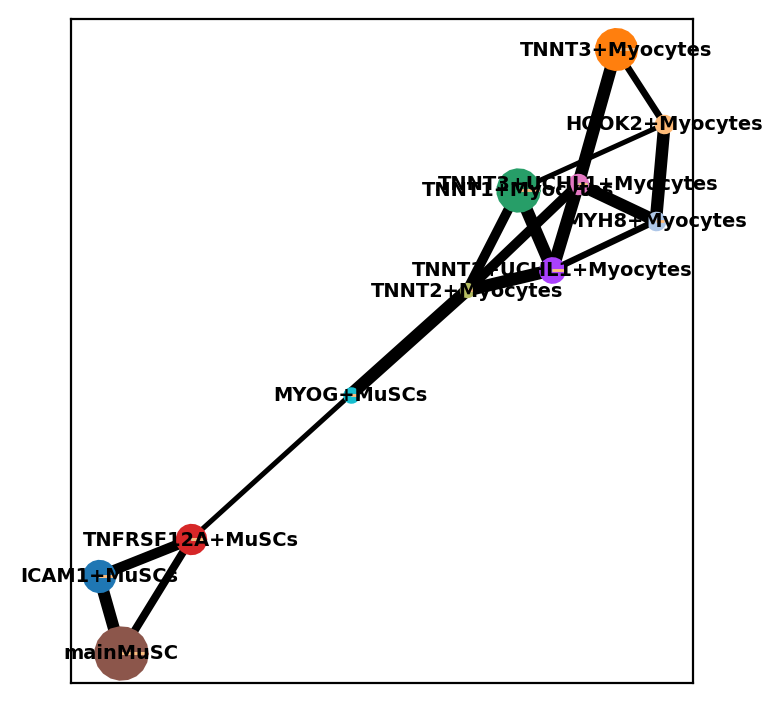

In [20]:
sc.pl.paga(adata, color=['annotation_2',],fontsize=7,threshold=.25,edge_width_scale=.6,node_size_scale=.5,save='humsn_SKM_MuSC_Myocyte_scVI_v1.3_paga_test2.pdf')

--> added 'pos', the PAGA positions (adata.uns['paga'])


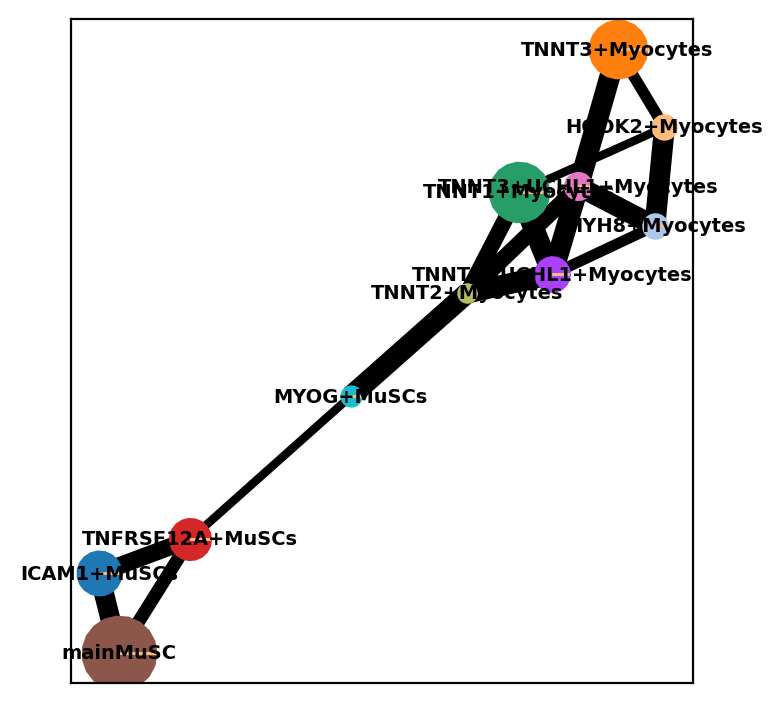

In [17]:
sc.pl.paga(adata, color=['annotation_2',],fontsize=7,threshold=.3)

--> added 'pos', the PAGA positions (adata.uns['paga'])


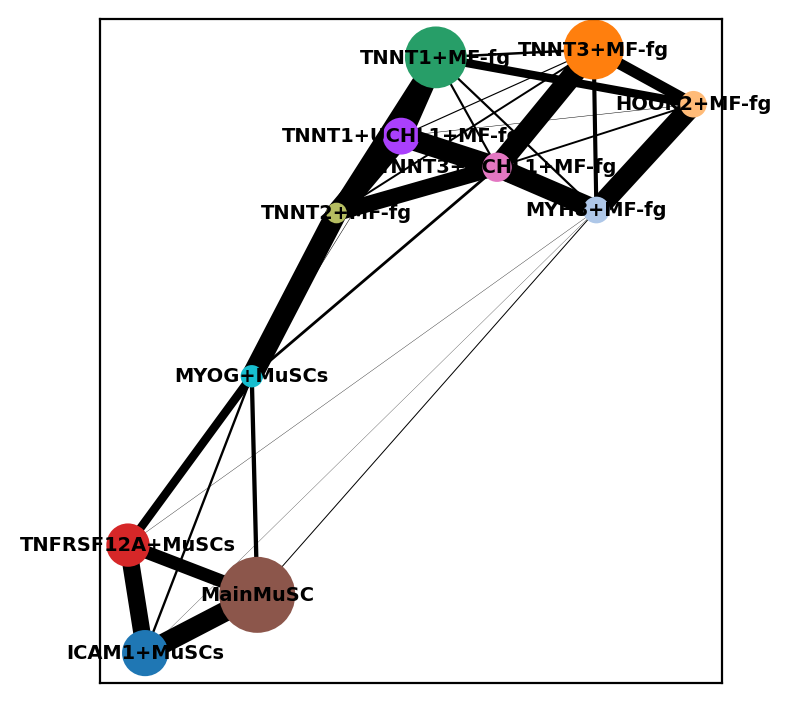

In [146]:
sc.pl.paga(adata, color=['annotation_2',],fontsize=7,)

--> added 'pos', the PAGA positions (adata.uns['paga'])


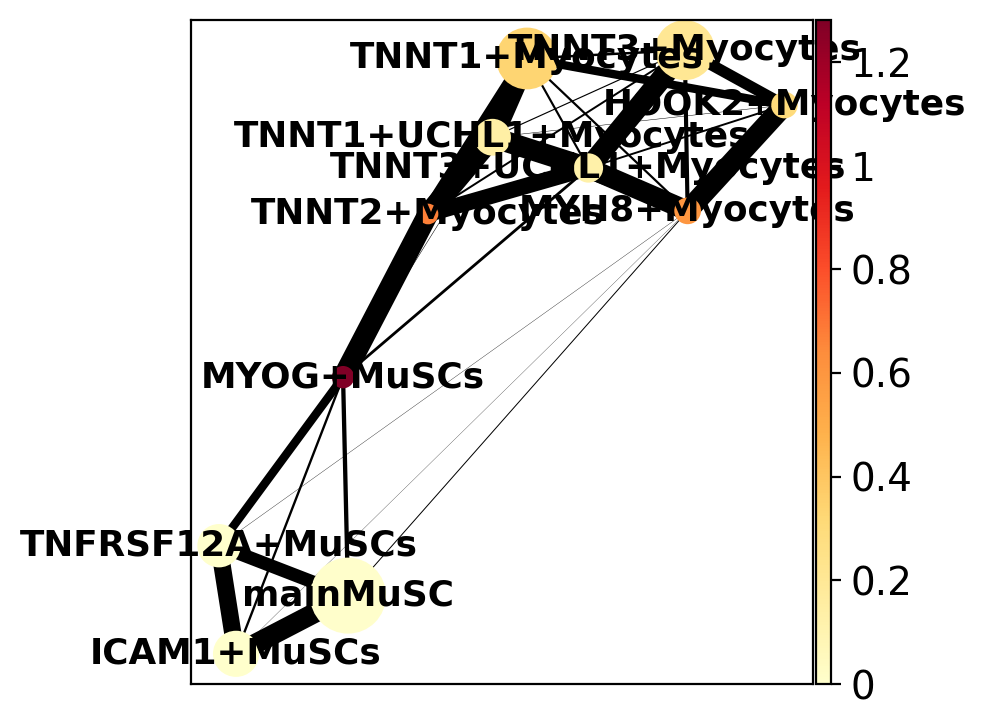

In [66]:
sc.pl.paga(adata, color=['MYOG'])

--> added 'pos', the PAGA positions (adata.uns['paga'])


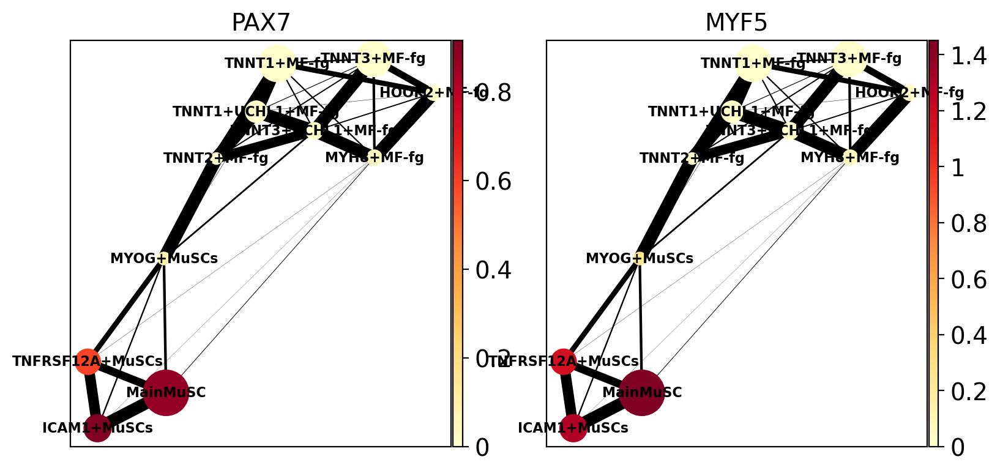

In [133]:
sc.pl.paga(adata, color=[ 'PAX7', 'MYF5',],fontsize=8)

--> added 'pos', the PAGA positions (adata.uns['paga'])


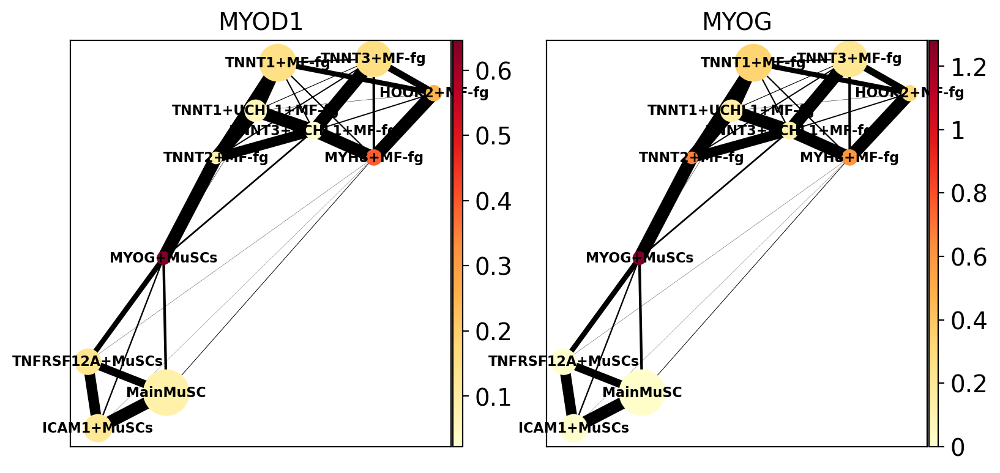

In [134]:
sc.pl.paga(adata, color=[  'MYOD1','MYOG'],fontsize=8)

--> added 'pos', the PAGA positions (adata.uns['paga'])


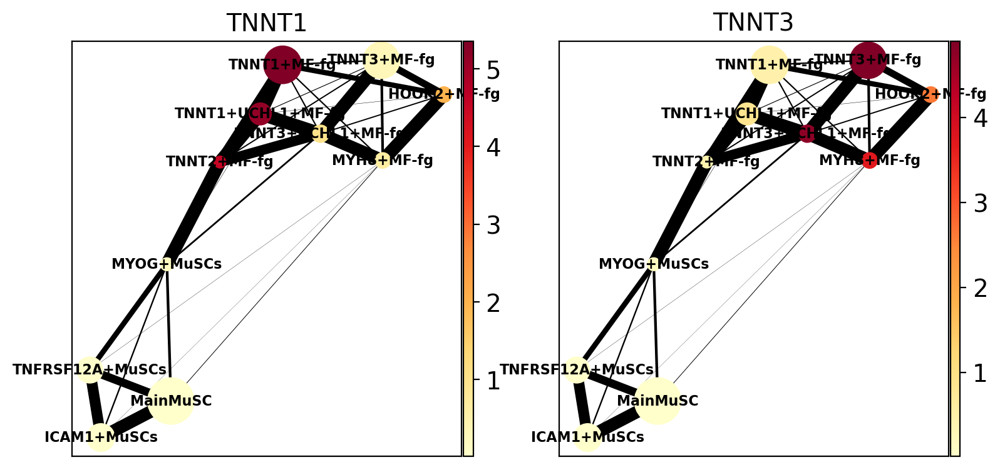

In [135]:
sc.pl.paga(adata, color=['TNNT1','TNNT3'],fontsize=8)

In [85]:
adata

AnnData object with n_obs × n_vars = 26885 × 10000
    obs: 'sample', 'barcode', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ', 'Age_bin', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'cell_type', 'annotation', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'leiden', 'annotation_1'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: '_scvi', 'hvg', 'leiden', 'neighbors', 'umap', 'leiden_colors', 'draw_graph', 'annotation_colors', 'annotation_1_colors', 'paga', 'annotation_1_sizes'
    obsm: 'X_scVI', 'X_umap', 'X_draw_graph_fa'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

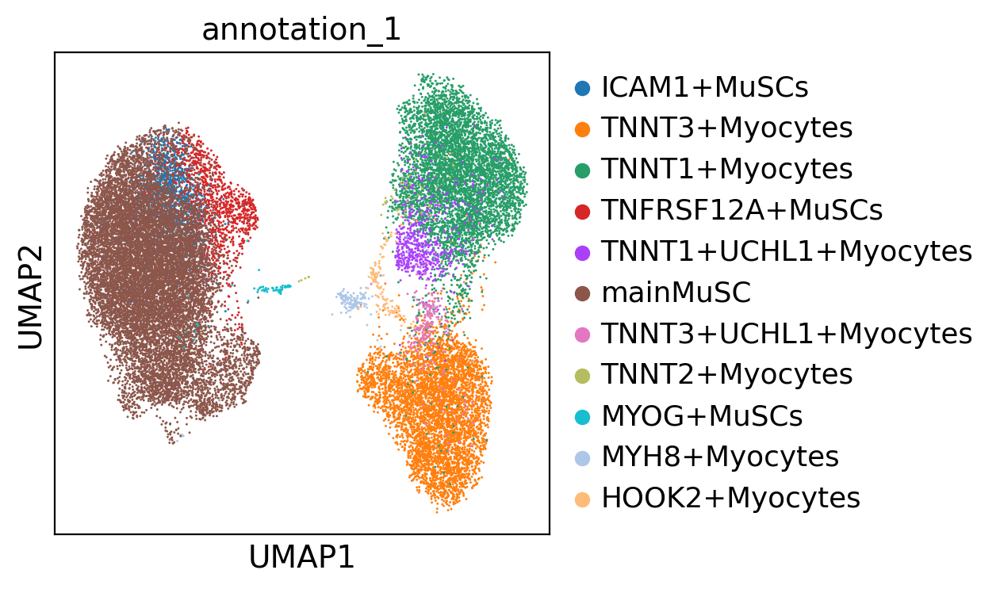

In [86]:
sc.pl.umap(adata, color='annotation_1',)

In [95]:
adata.uns['iroot'] = np.flatnonzero(adata.obs['annotation_1']  == 'mainMuSC')[0]

In [96]:
sc.tl.dpt(adata)

computing Diffusion Pseudotime using n_dcs=10
    finished: added
    'dpt_pseudotime', the pseudotime (adata.obs) (0:00:00)


In [97]:
adata

AnnData object with n_obs × n_vars = 26885 × 10000
    obs: 'sample', 'barcode', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ', 'Age_bin', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'cell_type', 'annotation', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'leiden', 'annotation_1', 'dpt_pseudotime'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: '_scvi', 'hvg', 'leiden', 'neighbors', 'umap', 'leiden_colors', 'draw_graph', 'annotation_colors', 'annotation_1_colors', 'paga', 'annotation_1_sizes', 'iroot', 'diffmap_evals'
    obsm: 'X_scVI', 'X_umap', 'X_draw_graph_fa', 'X_diffmap'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

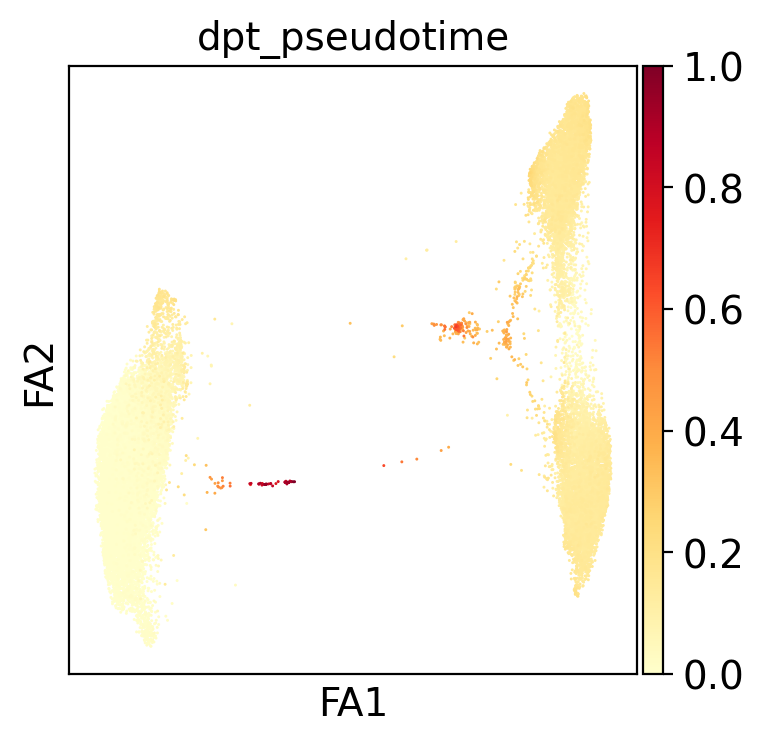

In [98]:
sc.pl.draw_graph(adata, color=['dpt_pseudotime'], legend_loc='on data')

In [31]:
collections.Counter(adata.obs['annotation'])

Counter({'0-ICAM1+MuSCs': 1571,
         '2-TNFRSF12A+MuSCs': 1203,
         '3-MuSCs': 12767,
         '5-MYOG+MuSCs': 65,
         '0-TNNT3+Myocytes': 4745,
         '1-TNNT1+Myocytes': 5385,
         '2-TNNT1+UCHL1+Myocytes': 597,
         '3-TNNT3+UCHL1+Myocytes': 220,
         '4-TNNT2+Myocytes': 45,
         '6-MYH8+Myocytes': 145,
         '7-HOOK2+Myocytes': 142})

In [33]:
adata.obs['annotation_1'] = adata.obs['annotation']

In [11]:
adata.obs['annotation_2'] = adata.obs['annotation_1']

In [12]:
new_cluster_name = ['ICA+ MuSC','MF-II(fg)','MF-I(fg)','TNF+ MuSC','I-UCH(fg)','Main MuSC','II-UCH(fg)','TNNT2+(fg)','MyG+ MuSC','MYH8+','HOOK2+']
adata.rename_categories('annotation_2', new_cluster_name)

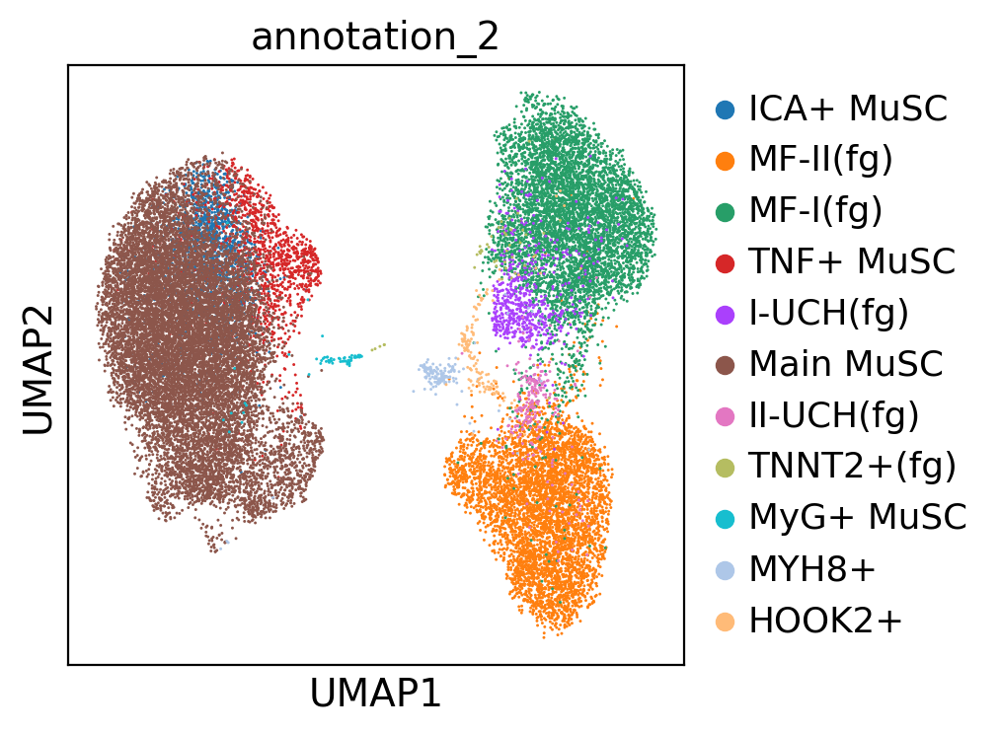

In [13]:
sc.pl.umap(adata, color='annotation_2', )

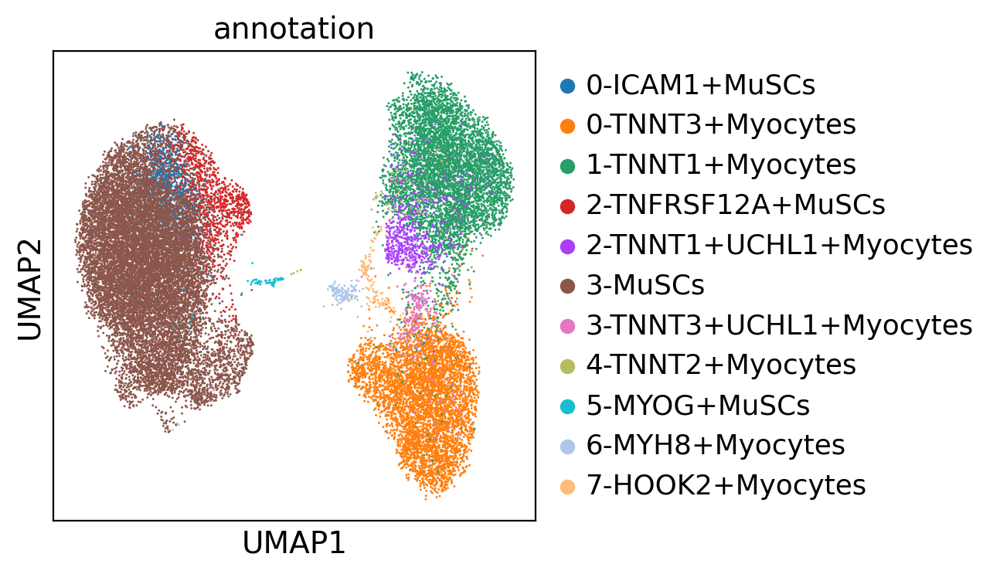

In [39]:
sc.pl.umap(adata, color='annotation', )

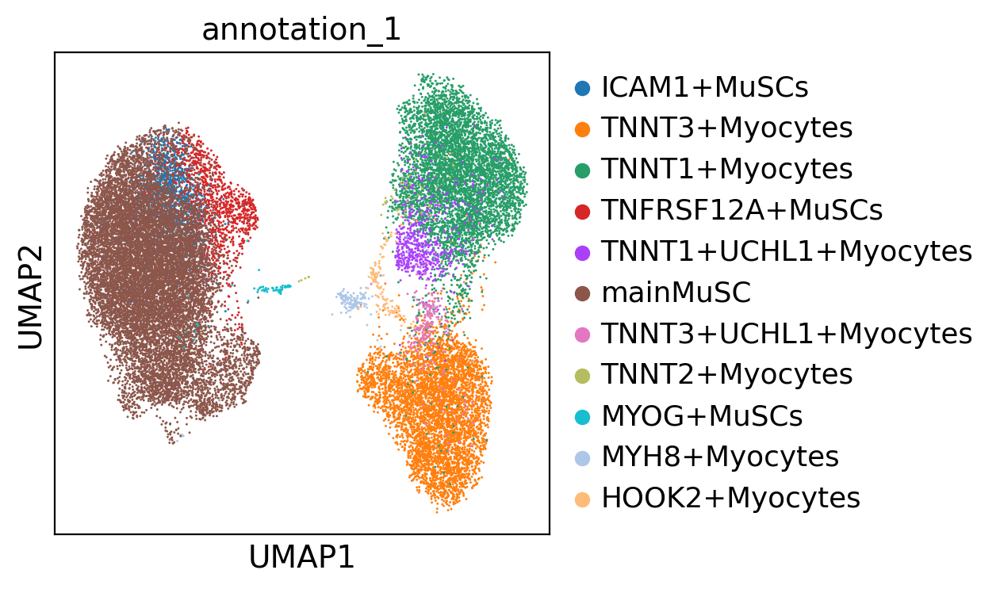

In [40]:
sc.pl.umap(adata, color='annotation_1', )

In [58]:
adata.uns['annotation_1_colors']

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78']

In [ ]:
['#ffbb78','#1f77b4','#8c564b','#aec7e8','#17becf','#d62728','#279e68','#aa40fc','#b5bd61','#ff7f0e','#e377c2']

In [43]:
adata_tnnt2myocyte = adata[adata.obs['annotation_1']=='TNNT2+Myocytes']

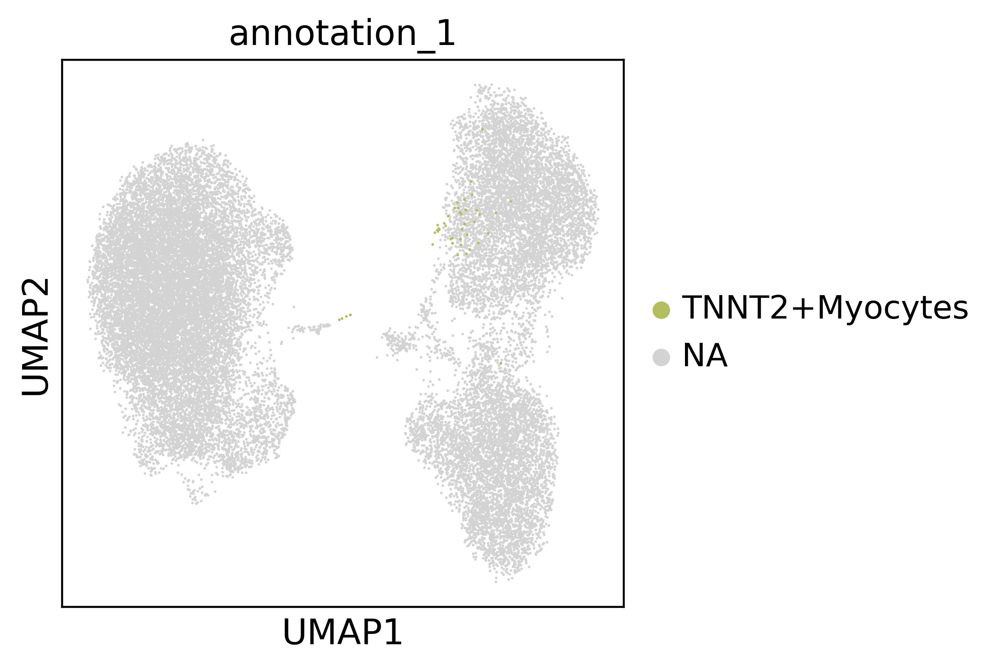

In [45]:
sc.settings.set_figure_params(dpi=200)
sc.pl.umap(adata, color='annotation_1',groups='TNNT2+Myocytes' )
sc.settings.set_figure_params(dpi=100)

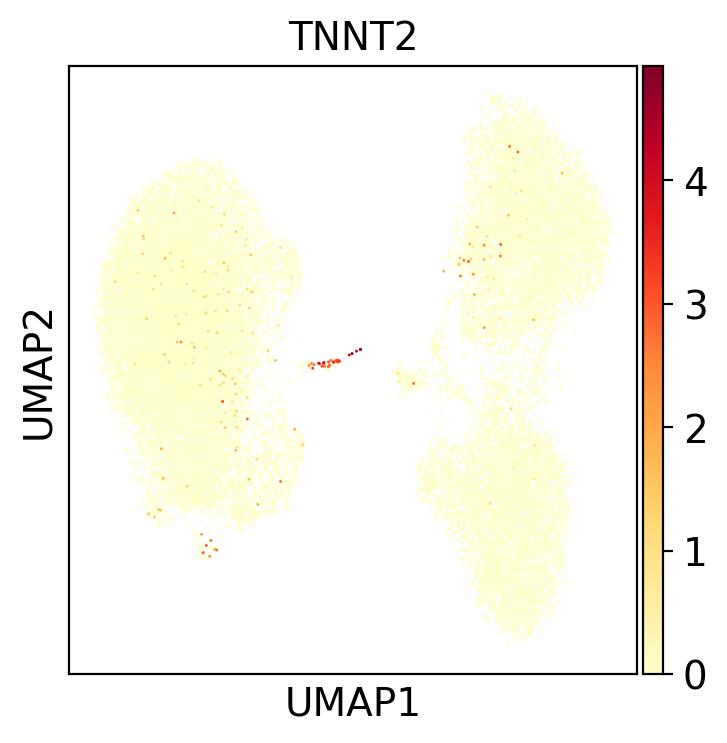

In [41]:
sc.pl.umap(adata, color='TNNT2', )

In [12]:
rawadata = sc.read('./write/skm_cells_human_cellbender.raw_2021-03-24.h5ad')

In [13]:
rawadata

AnnData object with n_obs × n_vars = 121841 × 33694
    obs: 'sample', 'barcode', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ', 'Age_bin', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells'

In [11]:
adata

AnnData object with n_obs × n_vars = 26885 × 10000
    obs: 'sample', 'barcode', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ', 'Age_bin', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'cell_type', 'annotation', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'leiden'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: '_scvi', 'hvg', 'leiden', 'neighbors', 'umap', 'leiden_colors', 'draw_graph', 'annotation_colors'
    obsm: 'X_scVI', 'X_umap', 'X_draw_graph_fa'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [15]:
raw_adata = rawadata[adata.obs.index]

In [16]:
raw_adata

View of AnnData object with n_obs × n_vars = 26885 × 33694
    obs: 'sample', 'barcode', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ', 'Age_bin', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells'

In [46]:
# 把 anndata文件转化成10X测序格式，方便读取到R中
time1 = time.time()
pd.DataFrame(raw_adata.var.index).to_csv( "./write/humsn_SKM_MuSC_Myocyte_scVI_v1.3/genes.tsv" ,   sep = "\t",header=False)
pd.DataFrame(raw_adata.obs.index).to_csv( "./write/humsn_SKM_MuSC_Myocyte_scVI_v1.3/barcodes.tsv", sep = "\t", index=False,header=False)
pd.DataFrame(raw_adata.var).to_csv( "./write/humsn_SKM_MuSC_Myocyte_scVI_v1.3/fdata.tsv",sep = "\t",header=True)
pd.DataFrame(adata.obs).to_csv( "./write/humsn_SKM_MuSC_Myocyte_scVI_v1.3/metadata.tsv",sep = "\t",header=True)
scipy.io.mmwrite("./write/humsn_SKM_MuSC_Myocyte_scVI_v1.3/matrix.mtx", raw_adata.X.T)
time2 = time.time()
print(time2-time1)

51.90469312667847


In [17]:
raw_adata.var.index

Index(['RP11-34P13.3', 'FAM138A', 'OR4F5', 'RP11-34P13.7', 'RP11-34P13.8',
       'RP11-34P13.14', 'RP11-34P13.9', 'FO538757.3', 'FO538757.2',
       'AP006222.2',
       ...
       'AC007325.2', 'BX072566.1', 'AL354822.1', 'AC023491.2', 'AC004556.1',
       'AC233755.2', 'AC233755.1', 'AC240274.1', 'AC213203.1', 'FAM231B'],
      dtype='object', length=33694)

In [28]:
print(adata.layers['counts'])

  (0, 6)	3.0
  (0, 12)	1.0
  (0, 13)	3.0
  (0, 42)	2.0
  (0, 49)	1.0
  (0, 51)	1.0
  (0, 55)	1.0
  (0, 61)	1.0
  (0, 70)	1.0
  (0, 77)	1.0
  (0, 86)	1.0
  (0, 91)	2.0
  (0, 115)	1.0
  (0, 121)	1.0
  (0, 132)	2.0
  (0, 133)	10.0
  (0, 141)	1.0
  (0, 154)	3.0
  (0, 162)	2.0
  (0, 167)	1.0
  (0, 181)	1.0
  (0, 186)	2.0
  (0, 188)	2.0
  (0, 199)	1.0
  (0, 204)	2.0
  :	:
  (26884, 9050)	1.0
  (26884, 9067)	2.0
  (26884, 9078)	1.0
  (26884, 9083)	1.0
  (26884, 9094)	5.0
  (26884, 9140)	1.0
  (26884, 9211)	1.0
  (26884, 9366)	16.0
  (26884, 9383)	3.0
  (26884, 9426)	2.0
  (26884, 9466)	39.0
  (26884, 9496)	10.0
  (26884, 9506)	2.0
  (26884, 9511)	1.0
  (26884, 9523)	3.0
  (26884, 9534)	6.0
  (26884, 9614)	1.0
  (26884, 9621)	4.0
  (26884, 9640)	1.0
  (26884, 9688)	6.0
  (26884, 9751)	12.0
  (26884, 9770)	5.0
  (26884, 9864)	1.0
  (26884, 9925)	1.0
  (26884, 9933)	1.0


In [29]:
# 把 anndata文件转化成10X测序格式，方便读取到R中
time1 = time.time()
pd.DataFrame(adata.var.index).to_csv( "./write/humsn_SKM_MuSC_Myocyte_scVI_v1.3/genes.tsv" ,   sep = "\t",header=False)
pd.DataFrame(raw_adata.obs.index).to_csv( "./write/humsn_SKM_MuSC_Myocyte_scVI_v1.3/barcodes.tsv", sep = "\t", index=False,header=False)
pd.DataFrame(adata.var).to_csv( "./write/humsn_SKM_MuSC_Myocyte_scVI_v1.3/fdata.tsv",sep = "\t",header=True)
pd.DataFrame(adata.obs).to_csv( "./write/humsn_SKM_MuSC_Myocyte_scVI_v1.3/metadata.tsv",sep = "\t",header=True)
scipy.io.mmwrite("./write/humsn_SKM_MuSC_Myocyte_scVI_v1.3/matrix.mtx", adata.layers['counts'].T)
time2 = time.time()
print(time2-time1)

24.136165618896484


***
Re-cluster

In [7]:
adata.obs['annotation_v2'] = adata.obs['annotation']

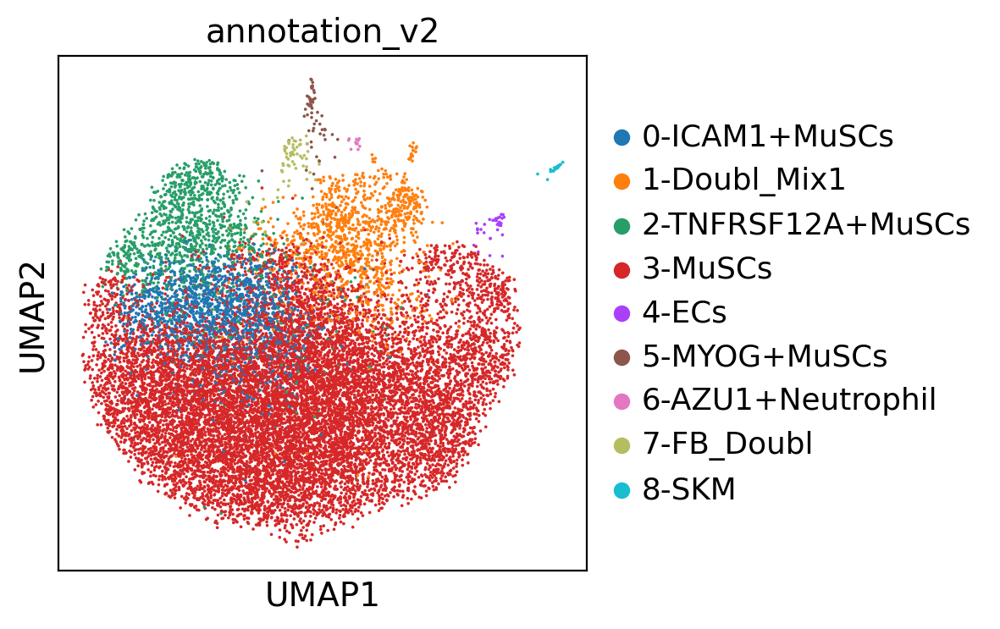

In [9]:
sc.pl.umap(adata, color=['annotation_v2'],)

running Leiden clustering
    finished: found 5 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:00)


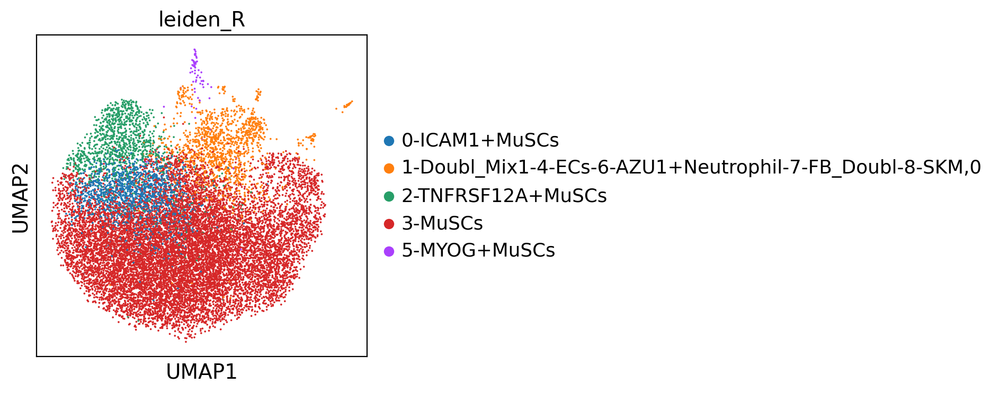

In [13]:
sc.tl.leiden(adata, resolution=.01, restrict_to=('annotation_v2', ['1-Doubl_Mix1','4-ECs','6-AZU1+Neutrophil','7-FB_Doubl','8-SKM']))
sc.pl.umap(adata, color='leiden_R')

In [14]:
adata.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata.obs['leiden_R'].cat.categories))]
adata.obs['annotation_v2'] = adata.obs['leiden_R']
del adata.obs['leiden_R']
# sc.pl.umap(adata, color='annotation', legend_loc='on data')

In [92]:
new_cluster_name = ['0-ICAM1+MuSCs','1-Doubl_Mix1','2-TNFRSF12A+MuSCs','3-MuSCs','4-ECs','5-MYOG+MuSCs','6-AZU1+Neutrophil','7-FB_Doubl','8-SKM']
adata.rename_categories('annotation', new_cluster_name)

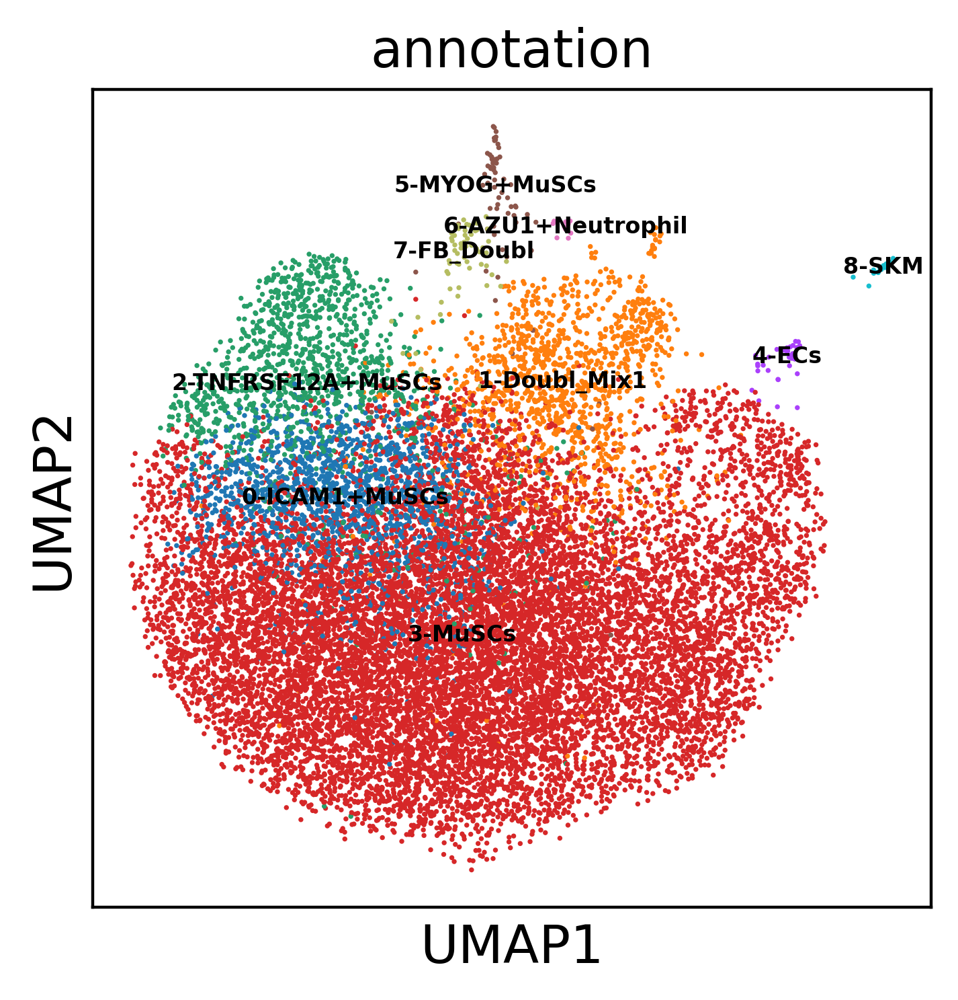

In [94]:
sc.settings.set_figure_params(dpi=200)
sc.pl.umap(adata, color=['annotation'],legend_loc='on data',legend_fontsize=6,)
sc.settings.set_figure_params(dpi=100)

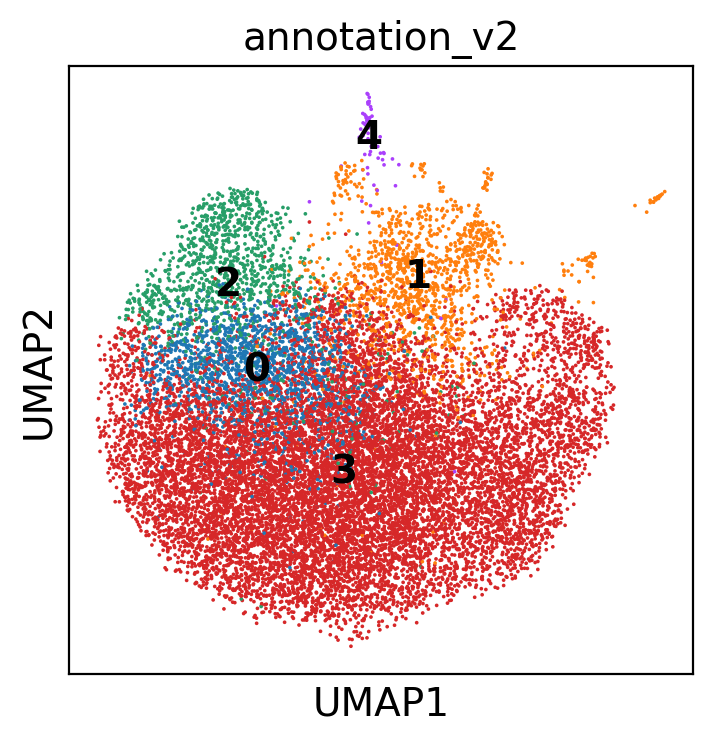

In [16]:
sc.pl.umap(adata, color=['annotation_v2'],legend_loc='on data')

In [43]:
new_cluster_name = ['CD56+MuSCs','Doubl_Mix','TNFRSF12A+MuSCs','Main-MuSCs','MYOG+MuSCs']
adata.rename_categories('annotation_v2', new_cluster_name)

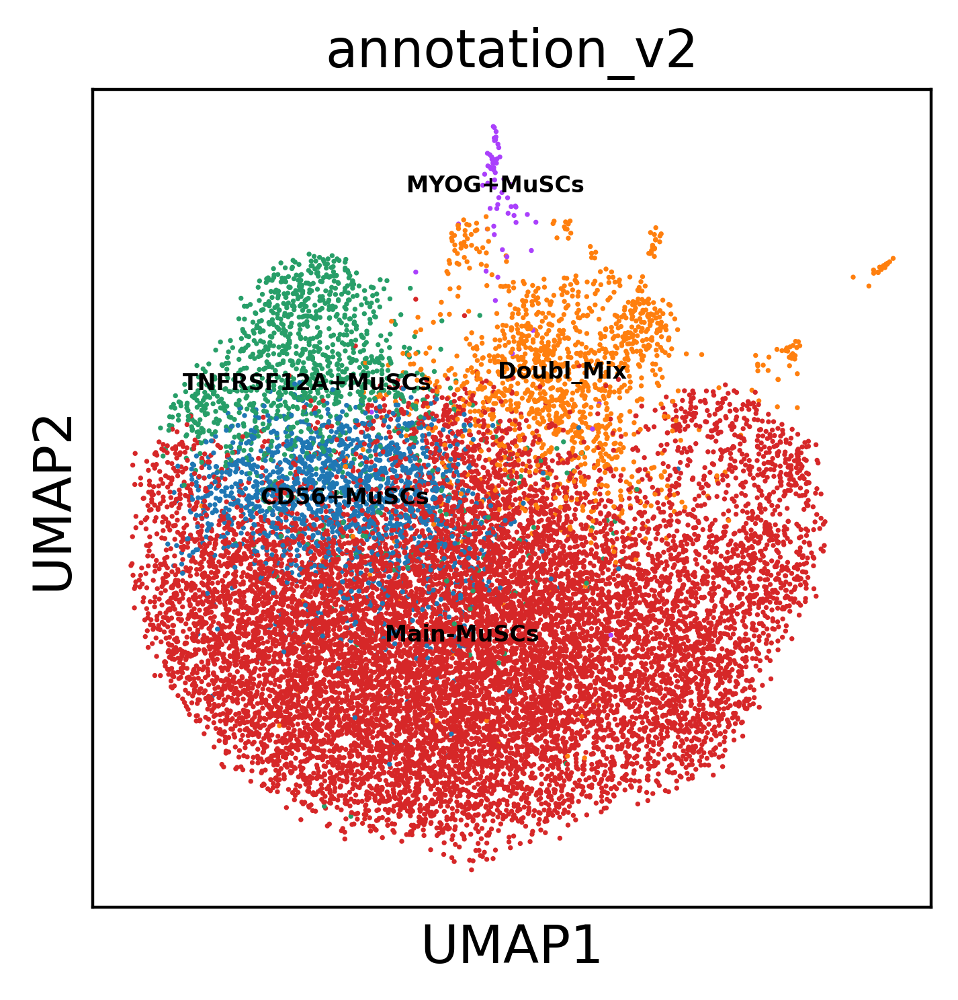

In [44]:
sc.settings.set_figure_params(dpi=200)
sc.pl.umap(adata, color=['annotation_v2'],legend_loc='on data',legend_fontsize=6,)
sc.settings.set_figure_params(dpi=100)

In [45]:
adata_mix_index = list(adata[adata.obs['annotation_v2']!='Doubl_Mix'].obs.index)
adata_clean = adata[adata_mix_index]

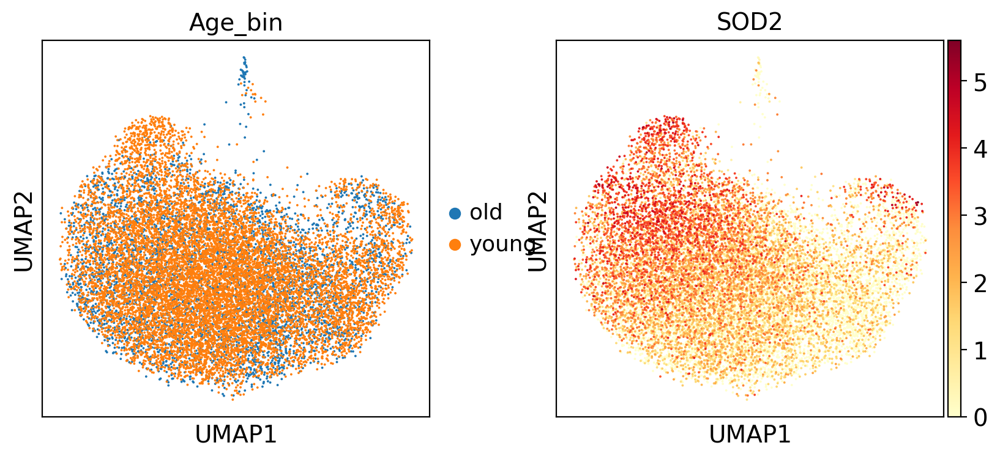

In [83]:
sc.pl.umap(adata_clean, color=['Age_bin','SOD2'])

Trying to set attribute `.uns` of view, copying.


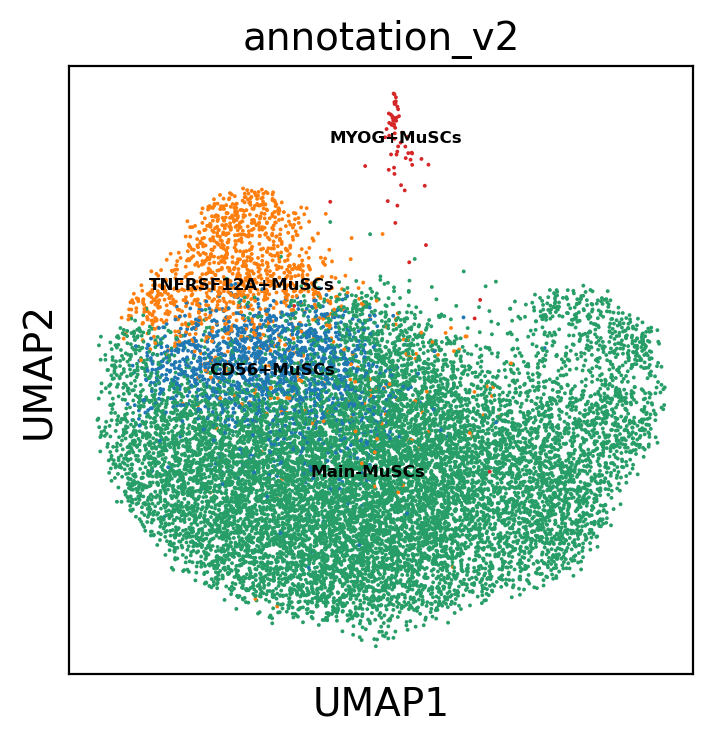

In [46]:
sc.pl.umap(adata_clean, color=['annotation_v2'],legend_loc='on data',legend_fontsize=6,)

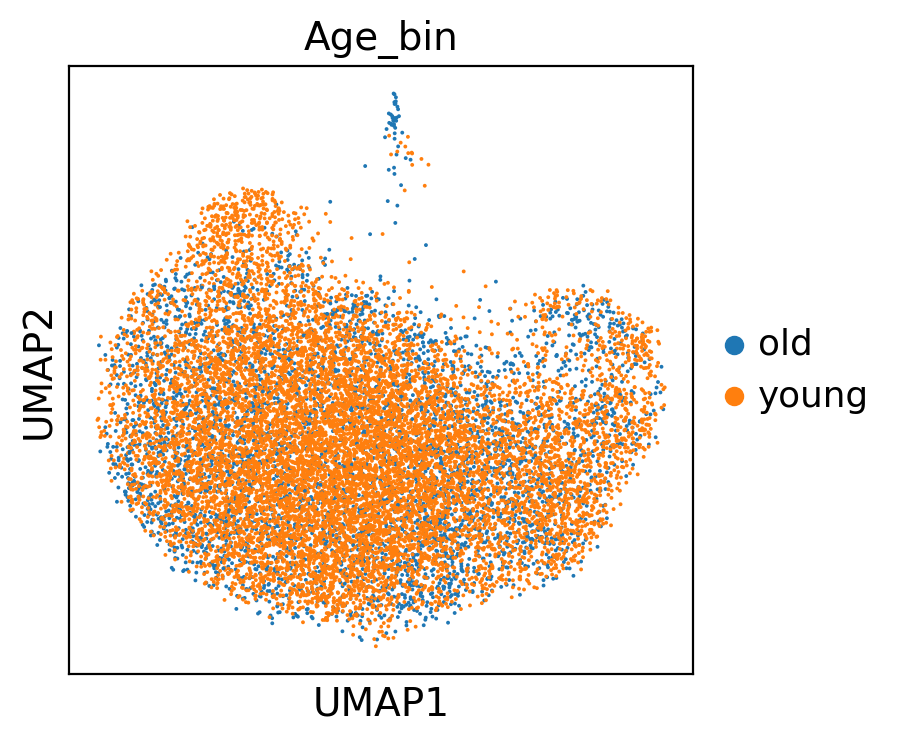

In [86]:
sc.pl.umap(adata_clean, color=['Age_bin'],save='humsn_SKM_MuSC_scVI_v2.0_age.pdf')

In [80]:
collections.Counter(adata_clean.obs['annotation_v2'])

Counter({'MYOG+MuSCs': 65,
         'Main-MuSCs': 12767,
         'TNFRSF12A+MuSCs': 1203,
         'CD56+MuSCs': 1571})

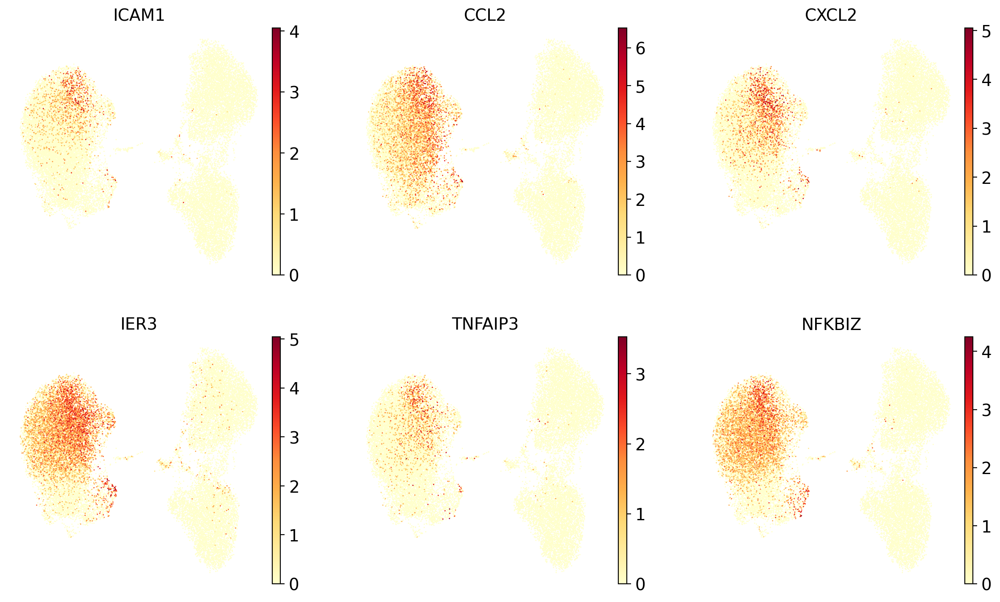

In [12]:
sc.pl.umap(adata, color=['ICAM1','CCL2','CXCL2','IER3','TNFAIP3','NFKBIZ',],ncols=3,frameon=False,
          )

In [ ]:
### 构建moli文件

In [36]:
rawdata = sc.read('./write/skm_cells_human_cellbender.raw_2021-03-24.h5ad')

In [48]:
adata_raw = rawdata[adata_clean.obs.index]

In [49]:
adata_raw

View of AnnData object with n_obs × n_vars = 15606 × 33694
    obs: 'sample', 'barcode', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ', 'Age_bin', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells'

In [50]:
adata_clean

AnnData object with n_obs × n_vars = 15606 × 10000
    obs: 'sample', 'barcode', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ', 'Age_bin', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'leiden', 'annotation', 'annotation_v2'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: '10X version _colors', 'DonorID_colors', '_scvi', 'hvg', 'leiden', 'leiden_R_colors', 'leiden_colors', 'neighbors', 'umap', 'annotation_v2_colors'
    obsm: 'X_scVI', 'X_umap'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [51]:
# 制作专门跑moli的数据
adata_diet = sc.AnnData(X = adata_raw.X, obs = adata_clean.obs, var = adata_raw.var, obsm = adata_clean.obsm )

In [52]:
adata_diet.write('./write/humsn_SKM_MuSC_scVI_v2.0_adata_diet.h5ad')

***
Marker genes

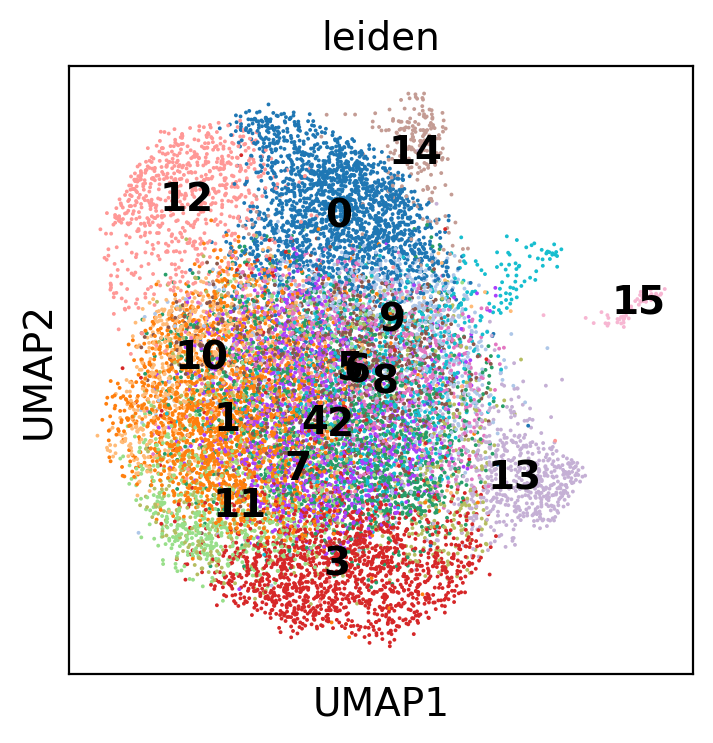

In [14]:
sc.pl.umap(adata, color=['leiden',],legend_loc='on data')

In [15]:
louvain_num = '14'

cdm_out = jp_single.calculate_markers(adata,group_key='leiden')

mult_marker_gene = jp_single.find_markers_multiple_v2(adata,cdm_out,thres=0.4,min_exp_cut=0.4)
sorted(mult_marker_gene[louvain_num], key=lambda student: student[1],reverse=True)

[('GPNMB', 0.8159702),
 ('PRUNE2', 0.73208237),
 ('ACTA2', 0.62580645),
 ('MT-ND3', 0.5483253),
 ('NEB', 0.52675927),
 ('GPX3', 0.49622673),
 ('MARCH6', 0.4939591),
 ('COX7A2L', 0.45179108),
 ('MT-CYB', 0.4214065)]

In [16]:
head = 63
list_gene = sorted(mult_marker_gene[louvain_num], key=lambda student: student[1],reverse=True)
if head>len(list_gene):
    head = len(list_gene)
gene_list = []
for i in range(head):
    gene_list.append(list_gene[i][0])
print(gene_list)

['GPNMB', 'PRUNE2', 'ACTA2', 'MT-ND3', 'NEB', 'GPX3', 'MARCH6', 'COX7A2L', 'MT-CYB']
